## Zaawansowane Metody Inteligencji Obliczeniowej
# Zadanie domowe 2
### Prowadzący: Michał Kempka
### Autor: Jakub Frąszczak 136704, czwartek 11:45

## Wprowadzenie

Zadania będą polegały na implementacji różnych wariantów algorytmu Q-Learning dla dwóch środowisk z biblioteki OpenAI Gym (https://gym.openai.com): `CartPole` i `LunarLander`.

#### Uwaga: Możesz dowolnie modyfikować elementy tego notebooka (wstawiać komórki i zmieniać kod) o ile nie napisano gdzieś inaczej.

In [ ]:
# Zainstaluj bibliotekę OpenAI Gym i PyTorch
!pip install gym torch matplotlib numpy box2d
# W wypadku problemów z działaniem `env.render()` na macOS Big Sur uruchom również poniższą linię
!pip install pyglet==1.5.15

     |████████████████████████████████| 1.3MB 2.8MB/s 
     |████████████████████████████████| 1.1MB 2.8MB/s 
ERROR: gym 0.17.3 has requirement pyglet<=1.5.0,>=1.4.0, but you'll have pyglet 1.5.15 which is incompatible.
  Found existing installation: pyglet 1.5.0
    Uninstalling pyglet-1.5.0:
      Successfully uninstalled pyglet-1.5.0


### Środowisko `CartPole` i `LunarLander`

Poniższy kod demonstruje działanie środowiska `CartPole` (https://gym.openai.com/envs/CartPole-v1) i `LunarLander` (https://gym.openai.com/envs/LunarLander-v2/).

In [ ]:
# Zobacz jak działają środowiska na przykładzie 1000 kroków
import gym

env = gym.make("CartPole-v1")
#env = gym.make("LunarLander-v2")
observation = env.reset()
for _ in range(1000):
    #env.render()
    action = env.action_space.sample()
    observation, reward, done, _ = env.step(action)

    if done:
        observation = env.reset()
env.close()

In [ ]:
# Zobacz jakim typem są obserwacje (reprezentacja stanu) oraz jaka jest przestrzeń akcji:
print("Przestrzeń stanów:", env.observation_space)
print("Rozmiar wektora reprezntującego stany:", env.observation_space.shape)
print("Ostatnia obserwacja:", type(observation), observation)
print("Przestrzeń akcji:", env.action_space)
print("Ilość możliwych akcji:", env.action_space.n)

Przestrzeń stanów: Box(-3.4028234663852886e+38, 3.4028234663852886e+38, (4,), float32)
Rozmiar wektora reprezntującego stany: (4,)
Ostatnia obserwacja: <class 'numpy.ndarray'> [ 0.03338825  0.5645069  -0.12198561 -1.05105739]
Przestrzeń akcji: Discrete(2)
Ilość możliwych akcji: 2


### Interface agenta

Wszystkie implementacje będą w oparciu o klasę `Agent` przedstawioną poniżej. Powinna ona implementować dwie metody: 1) `process_transition`, która będzie wykorzystywana tylko podczas uczenia by przekazać do agenta krotkę zawierającą obserwacje, podjętą akcję, nagrodę i następujący stan oraz informację czy jest on terminalny. 2) `get_action` która na podstawie obserwacji zwraca akcję, dodatkowy argument informuję Agenta czy jest w aktualnie podczas uczenia czy ewaluacji.

Poniżej znajdziiesz też funkcję `run_agent_in_env`, która korzysta z opisanego wyżej obiektu agenta w celu jego uczenia lub ewaluacji (podobną będziemy używać my podczas sprawdzania wszych rozwiązań). Możecie ją modyfikować jeśli widzicie taką potrzebę. Dopisaliśmy do tej funkcji rysowanie wykresu nagród z minionych epizodów, który uaktualnia się co ich zadaną liczbę.

In [ ]:
class Agent:
    def __init__(self, env):
        self.observation_space = env.observation_space
        self.action_space = env.action_space
    
    def process_transition(self, observation, action, reward, next_observation, done):
        raise NotImplementedError()
        
    def get_action(self, observation, learning):
        raise NotImplementedError()

In [ ]:
from collections import deque
import matplotlib.pylab as plt
from IPython import display
%matplotlib inline


def plot_rewards(rewards):
    plt.figure(figsize=(14,6))
    plt.plot(rewards)
    display.display(plt.gcf())
    display.clear_output(wait=True)

    
def run_agent_in_env(env, agent, episodes, learning=False, plot=False, plot_interval=1000):
    rewards = []
    last_rewards = deque(maxlen=30)
    rewards_to_plot = []
    for episode in range(episodes):
        observation = env.reset()
        total_reward = 0
        done = False
        while not done:
            # Zapytajmy agenta o akcje dla aktualnego stanu
            action = agent.get_action(observation, learning)
            
            # Wykonajmy akcje
            next_observation, reward, done, _ = env.step(action)
            total_reward += reward
            
            # Jeśli się uczymy, przekażmy przejście do agenta
            if learning:
                agent.process_transition(observation, action, reward, next_observation, done)
            
            observation = next_observation

        last_rewards.append(total_reward)
        rewards.append(total_reward)
        rewards_to_plot.append(sum(last_rewards) / len(last_rewards))
        
        # Wyświetl na wykresie nagrody otrzymane po kolei w epizodach
        if plot and episode % plot_interval == 0:
            plot_rewards(rewards_to_plot)
    return rewards     

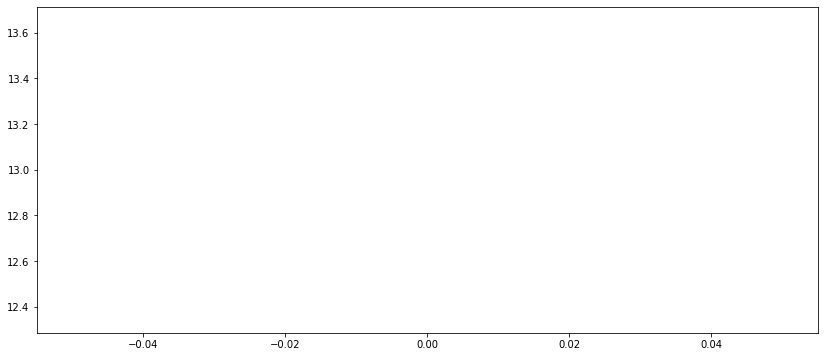

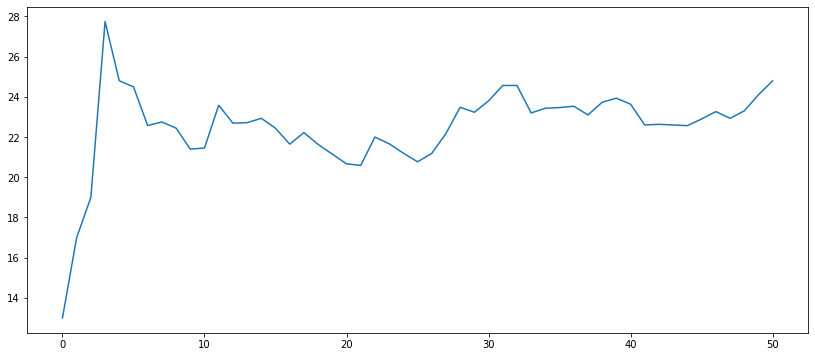

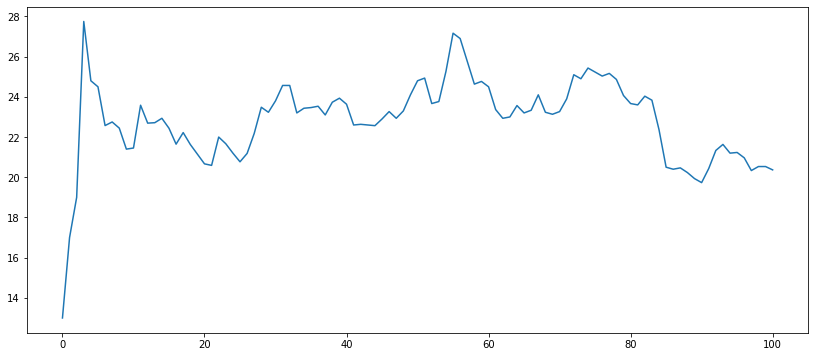

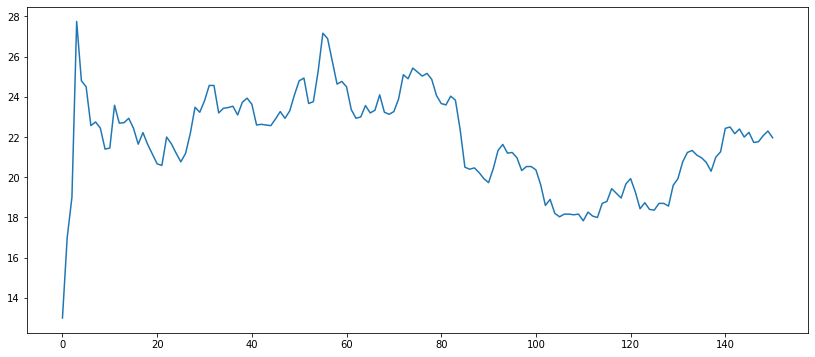

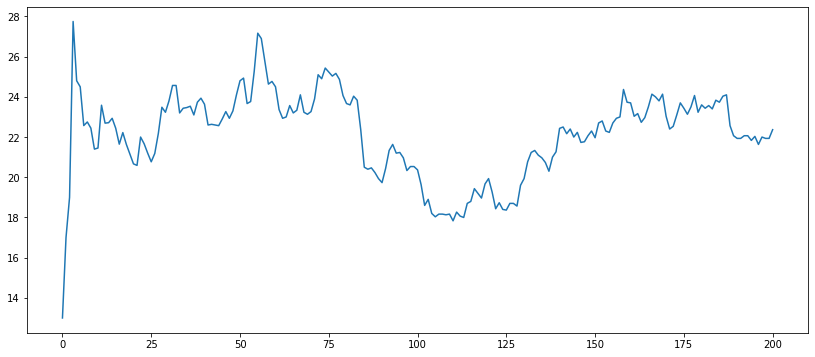

...

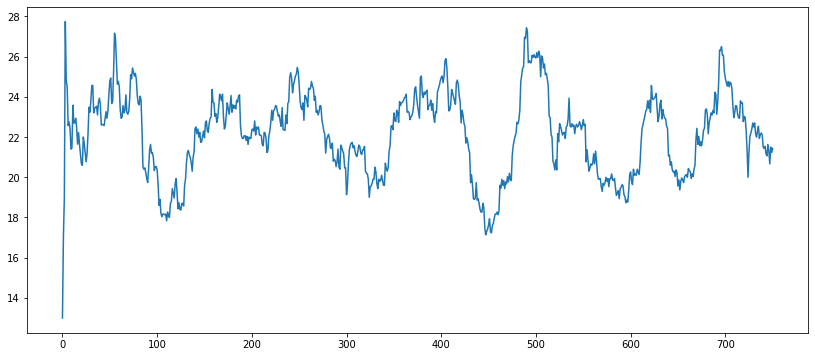

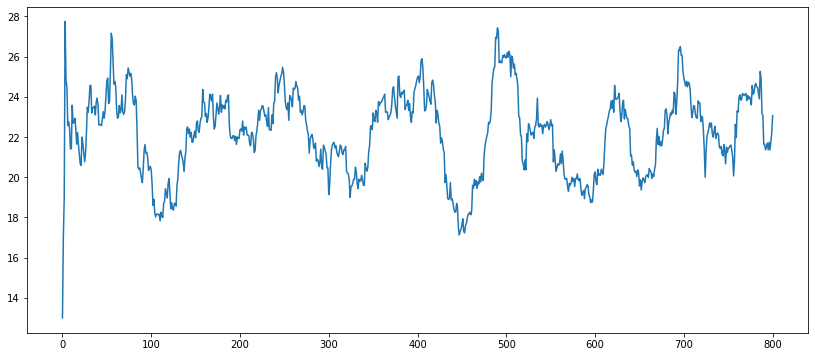

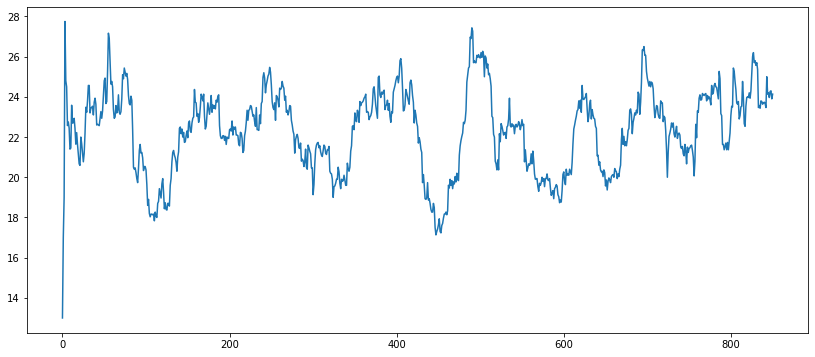

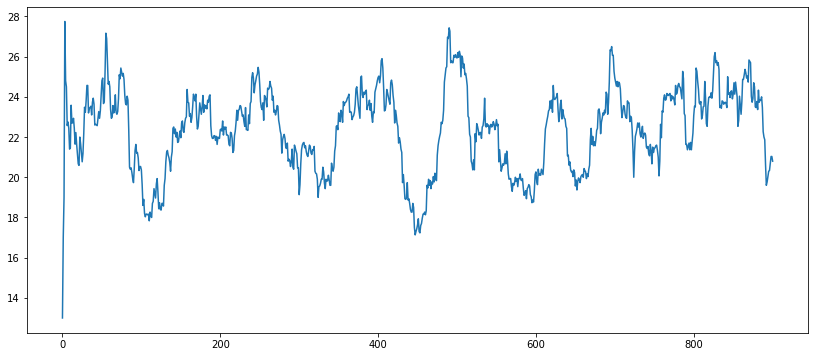

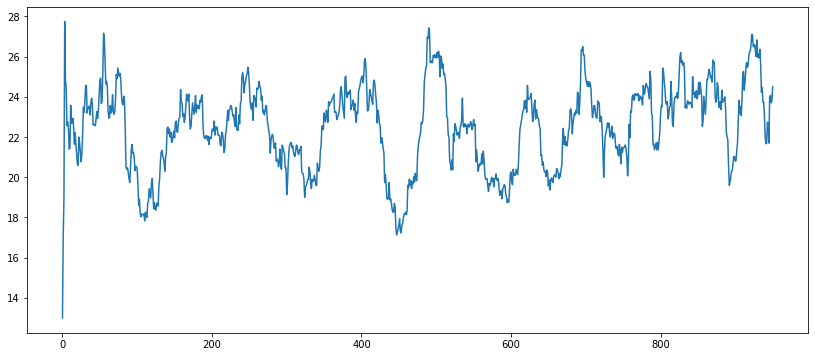

In [ ]:
# Demonstracja na przykładzie losowego agenta
env = gym.make("CartPole-v1")

class RandomAgent(Agent):
    def __init__(self, env):
        super().__init__(env)
    
    def process_transition(self, observation, action, reward, next_observation, done):
        pass
        
    def get_action(self, observation, learning):
        return self.action_space.sample()
    
random_agent = RandomAgent(env)
rewards = run_agent_in_env(env, random_agent, 1000, plot=True, plot_interval=50)

## Zad 1 - Tabularyczny Q-Learning (5pkt)

W komórkach poniżej zaimplementuj prosty tabularyczny Q-Learning dla środowiska `CartPole`, korzystający podczas uczenia się z polityki epsilon-greedy. Ponieważ środowisko `CartPole` ma ciągłą przesteń stanów musisz dokonać odpowiedniej dyskretyzacji stanów. 

Odpowiedź na pytanie: dlaczego po osiągnięciu dobrych wyników obserwujemy spadek jakości? Czy możemy temu jakoś zaradzić?

Uwagi:
- Dobra polityka dająca średni wynik powyżej 200, środowisko ma limit na 500 iteracji. Polityka dająca średni wynik blisko 500 jest więc bardzo dobra.
- Uczenie nie powinno trwać więcej niż 10-15 minut na CPU.
- Postaraj się dobrać i ustawić w `__init__` takie parametry by Twój Agent uczył się i działał jak najlepiej. Są one pod Twoją kontrolą w klasie, więc możesz je odpowiednio kontrolować w trakcie uczenia.


#### Uwaga: nie zmieniaj nazwy klasy `TabularQLearningAgent`, ani pozycyjnych (tych bez wartości domyślnych) argumentów jej metod, możesz dopisywać argumenty z wartościami domyślnymi oraz oczywiście pomocnicze meotdy do klasy. Nie dopisuj do komóreki z klasą innego kodu.

Odpowiedzi:

Opisana sytuacja jest związana ze zjawiskiem katastroficznego zapominania (catastrophic forgetting). Sieć po nauczeniu się i osiągnięciu dobrych wyników stosunkowo znacznie rzadziej będzie natrafiać na stany terminalne, czyli porażki danego epizodu. Z tego powodu sieć będzie miała tendencję do zbyt optymistycznych estymat stanów, tym samym ze stanami terminalnymi będzie związana nieadekwatnie wysoka estymata nagrody. To prowadzi właśnie do spadku jakości wyników.

By zmniejszyć ten problem konieczne byłoby regularne dostarczanie uczącej się sieci stanów o małej nagrodzie. W tym celu należałoby przechowywać w pamięci natrafione na początku uczenia stany z epizodów o małej łącznej nagrodzie i regularnie dostarczać je na etapie dalszego uczenia. Inną możliwością byłoby tymczasowe zwiększanie współczynnika epsilon, aby zwiększyć prawdopodobieństwo natrafienia na słabe stany.

W celu zwiększenia klarowności wykresów, dokonano ich wygładzenia poprzez wizualizację średnich wyników z ostatnich 30 epizodów.

W przypadku poniższego agenta tabularycznego, zjawisko to można najprawdopodobniej zaobserwować w okolicach 5000 iteracji, gdzie średnia jakość stopniowo wzrastała by nagle istotnie zmaleć. Później jednak sieć ponownie była w stanie zwiększyć średnie nagrody z epizodów.



In [ ]:
import numpy as np
import random

class TabularQLearningAgent(Agent):
    def __init__(self, env):
        super().__init__(env)

        self.epsilon = 0.2
        self.gamma = 0.95
        self.learning_rate = 0.1
        
        self.q_table = None
        self.bins = None
        self.observations_space_size = self.observation_space.shape[0]
        
    def initialize_q_table(self):
        num_of_bins = 30
        
        self.bins = [
            np.linspace(-4.8, 4.8, num_of_bins),
            np.linspace(-4, 4, num_of_bins),
            np.linspace(-.418, .418, num_of_bins),
            np.linspace(-4, 4, num_of_bins)
        ]

        self.q_table = np.random.normal(0, 1, size=([num_of_bins] * self.observations_space_size + [self.action_space.n]))

    def get_discrete_state(self, state):
        state_indices = []
        for i in range(self.observations_space_size):
            state_indices.append(np.digitize(state[i], self.bins[i]) - 1)
        return tuple(state_indices)
    
    def process_transition(self, observation, action, reward, next_observation, done):
        if not done:
            discrete_observation = self.get_discrete_state(observation)
            Q = self.q_table[discrete_observation + (action,)]
            
            discrete_next_observation = self.get_discrete_state(next_observation)
            best_next_action = self.get_action(next_observation, False)
            Q_next = self.q_table[discrete_next_observation + (best_next_action,)]
            
            self.q_table[discrete_observation + (action,)] -= self.learning_rate * (Q - (reward + self.gamma * Q_next))
               
    def get_action(self, observation, learning):
        discrete_state = self.get_discrete_state(observation)
        action_values = self.q_table[discrete_state]
        
        if learning:
            if random.random() < self.epsilon:
                return random.randint(0, self.action_space.n - 1)

        return np.argmax(action_values)
        

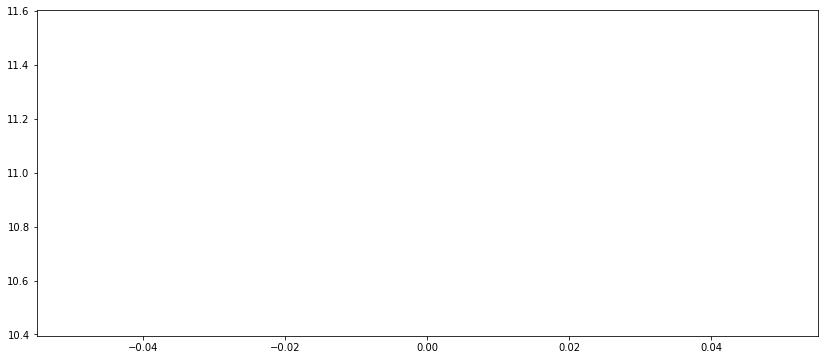

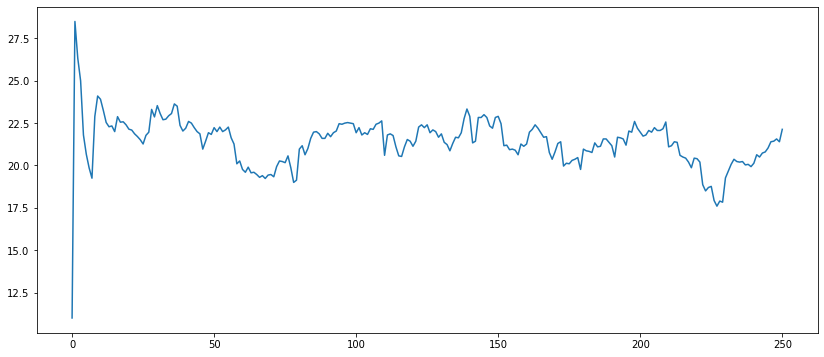

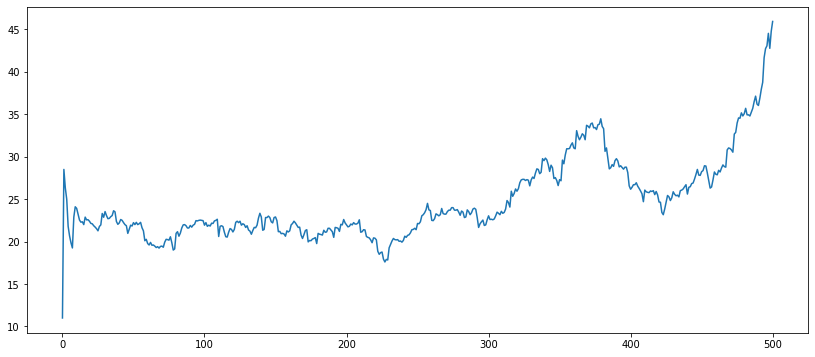

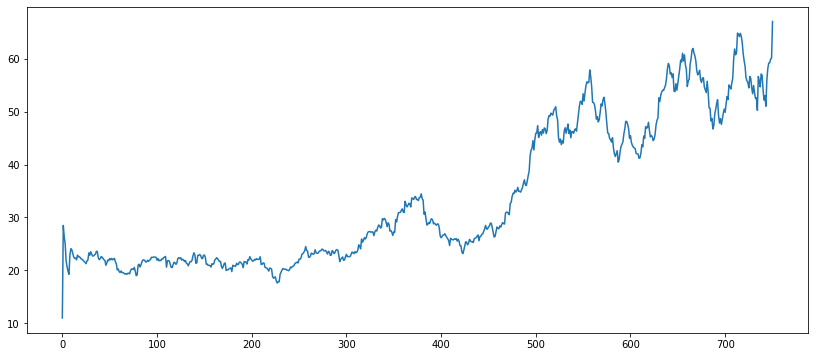

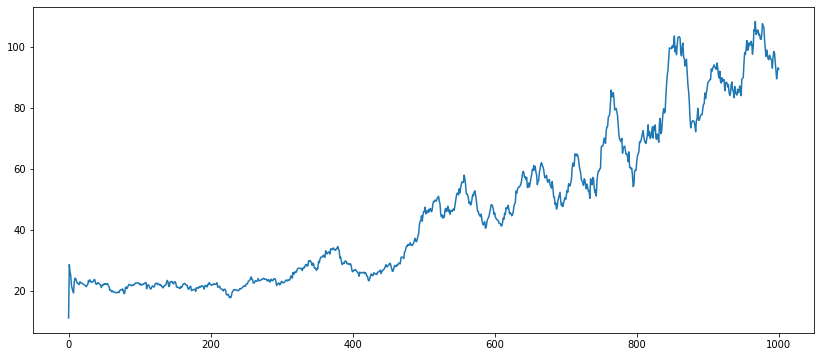

...

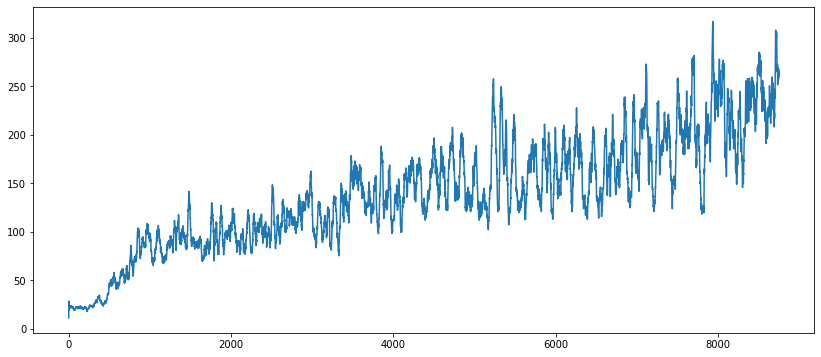

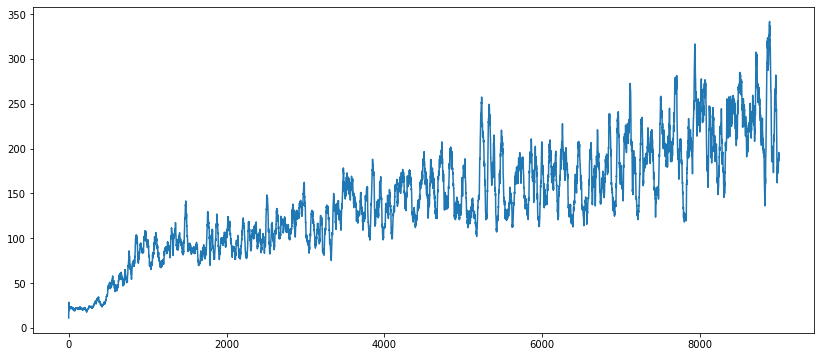

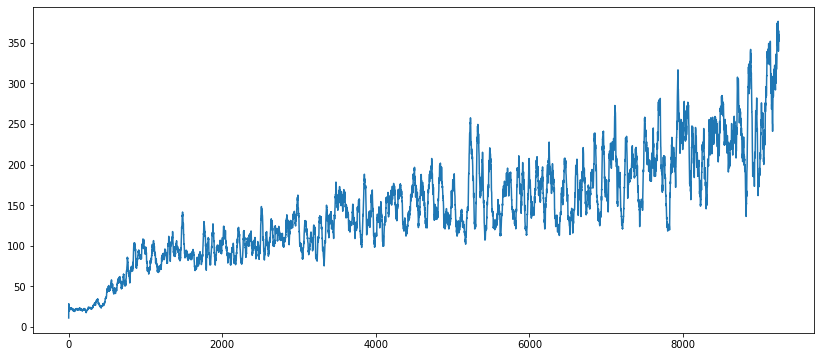

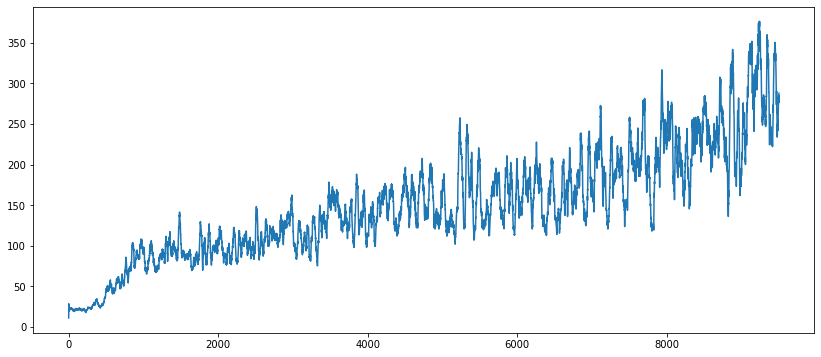

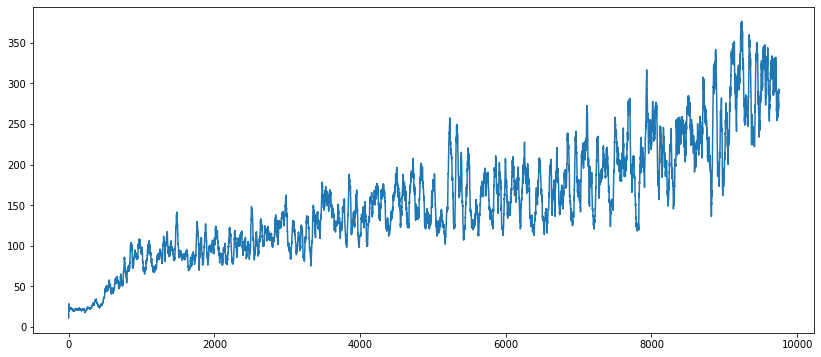

In [ ]:
# Uczenie/testowania agenta
env = gym.make("CartPole-v1")
agent = TabularQLearningAgent(env)
agent.initialize_q_table()

rewards = run_agent_in_env(env, agent, 10000, learning=True, plot=True, plot_interval=250)

In [ ]:
rewards = run_agent_in_env(env, agent, 1000, learning=False, plot=False)

print('Średni wynik')
print(sum(rewards) / len(rewards))

Średni wynik
381.502


## Zad 2 - Q-Learning z aproksymacją (25pkt)

W komórkach poniżej zaimplementuj Q-Learning z aproksymacją dla środowiska `LunarLander`, korzystający podczas uczenia się z polityki epsilon-greedy, a jako aproksymatora użyj prostej sieć neuronową zaimplementowanej z wykorzystaniem biblioteki PyTroch. Zaimplementuj następujące ulepszenia algorytmu Q-Learning:
- replay memory i uczenia batchowe zamiast uczenia online
- network freezing
- double q-learning

Porównaj ze sobą różne warianty algorytmu (nie duplikuj swojej implementacji, dodaj odpowiednie argumenty w konstruktorze, które będą włączać/wyłączać odpowiednie rozszerzenie), zademonstruj oczywiście swoje wyniki pozostawiając odpowiedni output z komórek oraz je skomentuj. Opisz również jak dokonałeś doboru parametrów Twojego modelu.

Uwagi:
- Dobra polityka powina mieć średnią bliską 100, bardzo dobra bliską 200.
- Uczenie nie powinno trwać więcej niż 10-15 minut (przy dobrze zaimplementowanych rozszerzeniach powinno być dużo szybsze) na CPU (możesz oczywiście użyć GPU jeśli masz taką możliwość, ale zadbaj by domyślnie Twoja implemnetacja działałą na CPU).
- Postaraj się dobrać i ustawić w `__init__` takie parametry (w tym architektuę sieci neuronowej) by Twój Agent uczył się i działał jak najlepiej. Są one pod Twoją kontrolą w klasie, więc możesz je odpowiednio kontrolować w trakcie uczenia.
- Założona architektura nie jest potrzebna do rozwiązania tego problemu, zacznij od prostego aproksymatora (np. liniowego albo sieci z dwoma warstwami) i stopniowo zwiększaj jego złożoność.
- Możesz najpierw testować swoją implementację na środowisku `CartPole`, jest to prostszy problem i z dobrymi parametrami nawet prosta wersja Q-Learningu z aproksymacją powinna się go uczyć w nie więcej niż 2-3 minuty na CPU.

#### Uwaga: nie zmieniaj nazwy klasy `NeuralQLearningAgent`, ani pozycyjnych (tych bez wartości domyślnych) argumentów jej metod, możesz dopisywać argumenty z wartościami domyślnymi oraz oczywiście pomocnicze meotdy do klasy. Nie dopisuj do komóreki z klasą innego kodu.

Odpowiedzi:

Już podstawowa wersja agenta, bez zastosowania dodatkowych usprawnień, po nauczeniu była w stanie otrzymywać średnie łączne nagrody z epizodów na poziomie około 140.

Stosując memory replay z pamięcią o rozmiarze 1000, z batchem obserwacji o rozmiarze 8 i aktualizując sieć co 8 kroków, pomimo większej tendencji do katastroficznego zapominania na etapie uczenia, zauważalne są istotnie lepsze wyniki osiągane w trakcie testowania agenta, gdyż oscylowały one na poziomie około 210.

Wprowadzenie zamrażania sieci, z odmrażaniem wag co 20 kroków, także przynosi zauważalny wzrost sumarycznych nagród z epizodów, gdyż średnia ta na etapie testowania agenta wyniosła około 230.

Zastosowanie jednak obu powyższych usprawnień jednocześnie, umożliwiło kolejną poprawę średnich nagród, wynoszącą 260.

W przypadku double q-learningu, rozpatrzone zostały 3 wersje algorytmu. Pierwsza wersja jest oparta na posiadaniu 2 sieci, zupełnie analogicznie jak w wersji tabularycznej, natomiast dwie kolejne wykorzystują double deep q-learning (bazujące także na zamrażaniu sieci). Jedna wersja jednak jest uczona w każdym kroku natomiast w przypadku drugiej wykorzystano memory replay.
Wszystkie te 3 wersje umożliwiają otrzymanie polityki o wysokiej jakości. Zauważalna jest jednak tendecja wzrostowa pod względem średnich łącznych nagród wraz z rozszerzaniem wykorzystanych usprawnień. Wersja podstawowa oscyluje w okolicach 190 ale double deep q-learning osiąga już łączne nagrody wynoszące 220. Dodanie memory replay tylko zwiększa jakość polityki, o czym świadczą nagrody równe 250.

W ramach podsumowania, można zauważyć, że najlepsze polityki zostały wytrenowane za pomocą algorytmu Q-learning z memory replay i zamrażaniem sieci oraz algorytmu Double Deep Q-learning z memory replay (algorytm ten ma wbudowaną ideę network freezingu, jedynie ją rozszerza więc można powiedzieć, że wykorzystuje wszystkie 3 zaimplementowane usprawnienia). Dodanie powyższych trzech rozszerzeń, w sposób oczekiwany spowodowało wzrost łącznych nagród. Jedynie nie zaobserwowano poprawy wyników stosując Double Deep Q-learningu, w porównaniu do stosowania zwykłego zamrażania sieci.

Dobór parametrów modelu następował w sposób przyrostowy. Najpierw dla wersji podstawowej, bazując na wartościach parametrów zaczerpniętych z literatury oraz serii eksperymentów wybrano podstawowe parametry jak epsilon, epsilon decay, minimalna wartość epsilonu, współczynnik gamma oraz learning rate. Następnie dla każdego kolejnego rozszerzenia bazowano na parametrach z podstawowej wersji i nowe analogicznie dobierano poprzez przeprowadzenie serii eksperymentów. 



In [ ]:
!pip install torchvision

In [ ]:
import torch
from torch.autograd import Variable
import torchvision.transforms as T

class DeepQNeuralNetwork():
    def __init__(self, state_dim, action_dim, lr=0.0001):
            self.loss_function = torch.nn.MSELoss()
            self.model = torch.nn.Sequential(
                            torch.nn.Linear(state_dim, 128),
                            torch.nn.ReLU(),
                            torch.nn.Linear(128, 128),
                            torch.nn.ReLU(),
                            torch.nn.Linear(128, action_dim)
                        )
            self.optimizer = torch.optim.Adam(self.model.parameters(), lr)

    def update(self, state, y):
            y_pred = self.model(torch.Tensor(state))
            loss = self.loss_function(y_pred, Variable(torch.Tensor(y)))
            self.optimizer.zero_grad()
            loss.backward()
            self.optimizer.step()
            
    def predict(self, state):
            with torch.no_grad():
                return self.model(torch.Tensor(state))

In [ ]:
from copy import deepcopy
from collections import deque

class NeuralQLearningAgent(Agent):
    def __init__(self, env, memory_replay=False, network_freezing=False, double_q_learning=False, tabularlike_double_qlearning=False):
        super().__init__(env)
        
        self.memory_replay = memory_replay
        self.network_freezing = network_freezing
        self.double_q_learning = double_q_learning
        self.tabularlike_double_qlearning = tabularlike_double_qlearning
        
        self.epsilon = 0.9
        self.epsilon_decay = 0.999
        self.min_epsilon = 0.1
        self.gamma = 0.99
        self.learning_rate = 0.001

        if self.network_freezing or self.double_q_learning:
          self.learning_rate /= 2
        
        self.model = DeepQNeuralNetwork(self.observation_space.shape[0], self.action_space.n, lr=self.learning_rate)
        
        self.frozen_model = deepcopy(self.model)
        self.frequency_of_frozen_network_update = 20
        
        self.memory = deque(maxlen=1000)
        self.replay_frequency = 8
        self.replay_batch_size = 8
        
        self.second_model = deepcopy(self.model)
        
        self.iterations = 0
    
    def process_transition(self, observation, action, reward, next_observation, done):
      if self.tabularlike_double_qlearning:
        self.perform_tabularlike_double_q_learning(observation, action, reward, next_observation, done)
        self.epsilon = max(self.epsilon * self.epsilon_decay, self.min_epsilon)
        return

      if self.memory_replay:
          self.memory.append((observation, action, reward, next_observation, done))

          if self.iterations % self.replay_frequency == 0:
            self.replay()
      else:
          Q = self.calculate_target(observation, action, reward, next_observation, done)
          self.model.update(observation, Q)
          
      if self.network_freezing:
          if self.iterations % self.frequency_of_frozen_network_update == 0:
              self.frozen_model = deepcopy(self.model)

      self.epsilon = max(self.epsilon * self.epsilon_decay, self.min_epsilon)
      self.iterations += 1
            
    def get_action(self, observation, learning):
        if learning:
            if random.random() < self.epsilon:
                return self.action_space.sample()
        action_values = self.model.predict(observation)
        return torch.argmax(action_values).item()
    
    def replay(self):
        batch = random.sample(self.memory, min(self.replay_batch_size, len(self.memory)))
        batch_observations = []
        batch_q_values = []
        
        for observation, action, reward, next_observation, done in batch:
            Q = self.calculate_target(observation, action, reward, next_observation, done)
            batch_observations.append(observation)
            batch_q_values.append(Q)
        
        self.model.update(batch_observations, batch_q_values)
    
    def calculate_target(self, observation, action, reward, next_observation, done):
        if done:
            y = reward
        else:
            if self.network_freezing and self.double_q_learning:
                y = self.calculate_y_double_dqn(observation, action, reward, next_observation, done)
            elif self.network_freezing:
                y = self.calculate_y_network_freezing(observation, action, reward, next_observation, done)
            else:
                y = self.calculate_y_default(observation, action, reward, next_observation, done)
        Q = self.model.predict(observation).tolist()
        Q[action] = y
        
        return Q
    
    def calculate_y_default(self, observation, action, reward, next_observation, done):
        Q = self.model.predict(observation).tolist()
        Q_next = torch.max(self.model.predict(next_observation)).item()
        y = reward + self.gamma * Q_next
        
        return y
    
    def calculate_y_network_freezing(self, observation, action, reward, next_observation, done):
        Q = self.model.predict(observation).tolist()
        Q_next = torch.max(self.frozen_model.predict(next_observation)).item()
        y = reward + self.gamma * Q_next
            
        return y
        
    def calculate_y_double_dqn(self, observation, action, reward, next_observation, done):
        Q = self.model.predict(observation).tolist()
        next_action = self.model.predict(next_observation).argmax().item()
        Q_next = self.frozen_model.predict(next_observation)[next_action].tolist()
        y = reward + self.gamma * Q_next
            
        return y
    
    def perform_tabularlike_double_q_learning(self, observation, action, reward, next_observation, done):
        y = reward
        if random.random() < 0.5:
            if not done:
                next_action = self.model.predict(next_observation).argmax().item()
                Q_next = self.second_model.predict(next_observation)[next_action].tolist()
                y = reward + self.gamma * Q_next
            Q = self.model.predict(observation).tolist()
            Q[action] = y
            self.model.update(observation, Q)
        else:
            if not done:
                next_action = self.second_model.predict(next_observation).argmax().item()
                Q_next = self.model.predict(next_observation)[next_action].tolist()
                y = reward + self.gamma * Q_next
            Q = self.second_model.predict(observation).tolist()
            Q[action] = y
            self.second_model.update(observation, Q)

# 1. Wersja podstawowa bez usprawnień

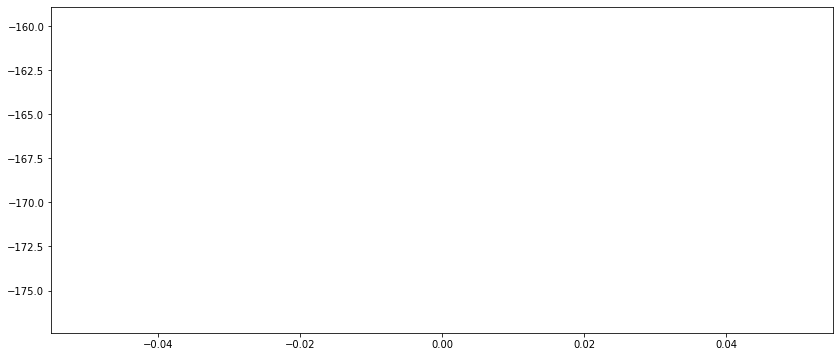

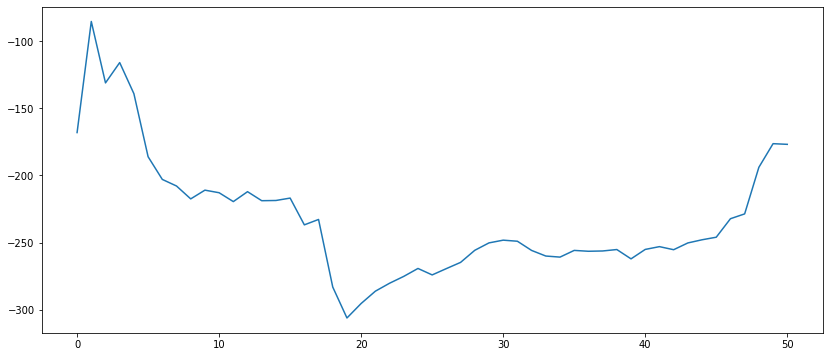

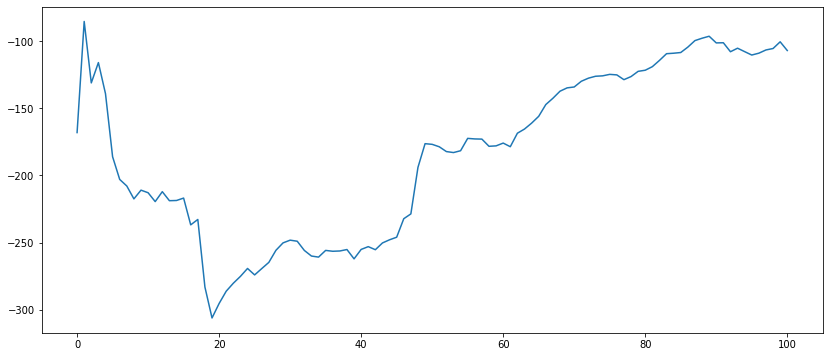

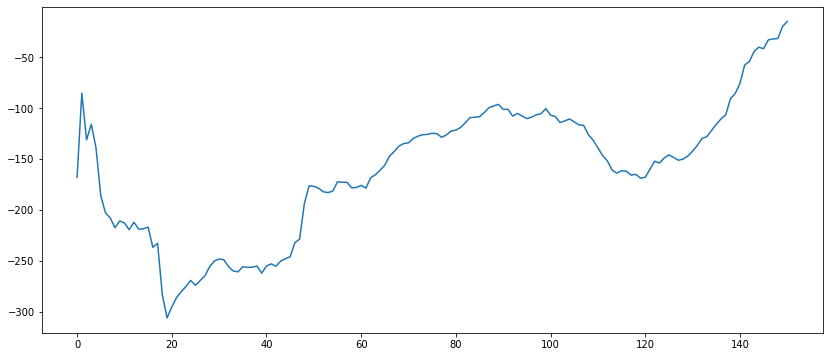

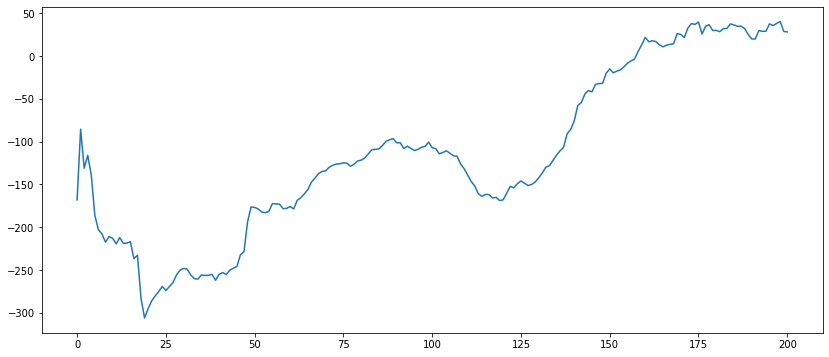

...

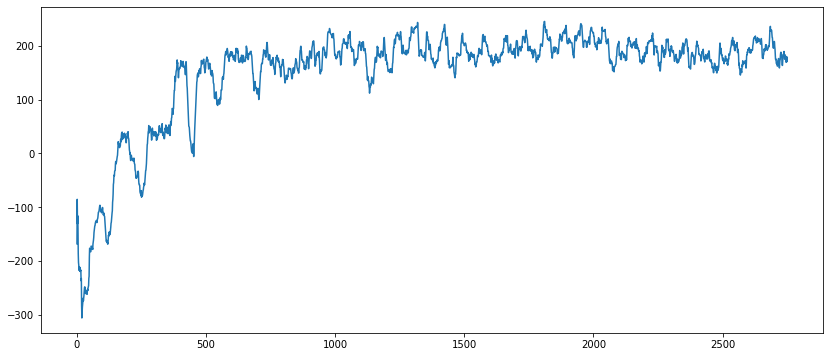

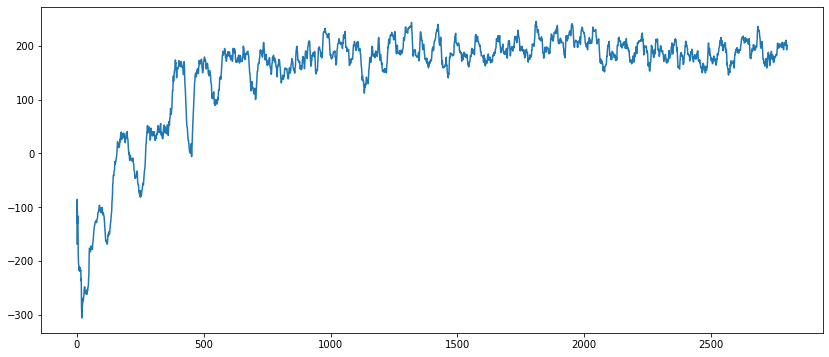

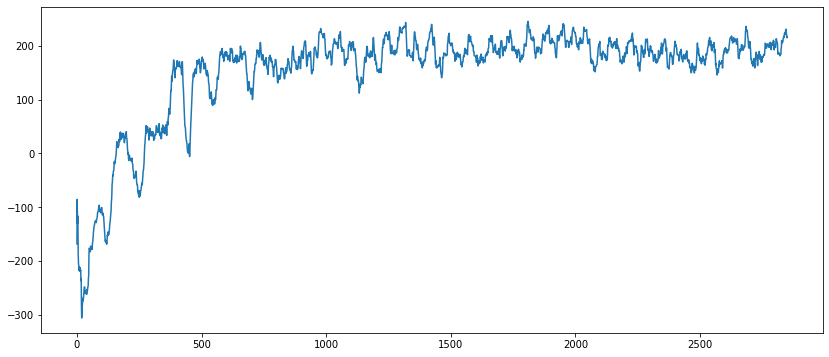

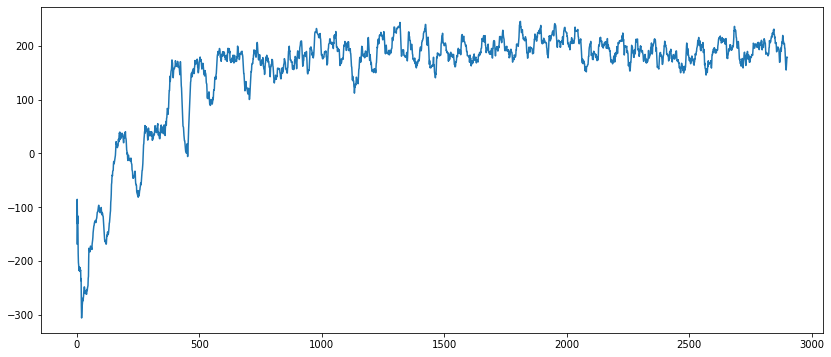

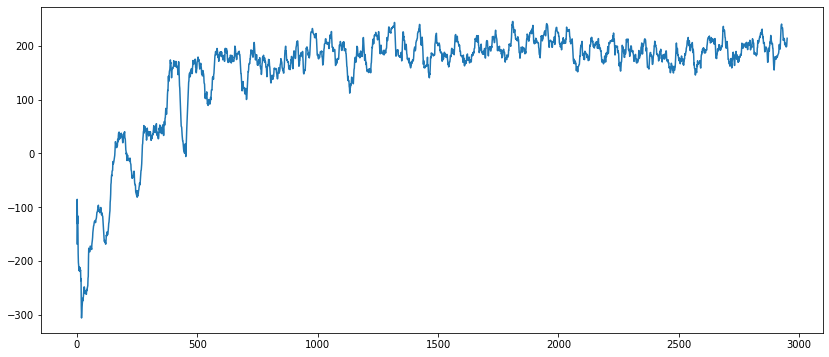

In [ ]:
env = gym.make("LunarLander-v2")
agent = NeuralQLearningAgent(env, memory_replay=False, network_freezing=False, double_q_learning=False)
rewards = run_agent_in_env(env, agent, 3000, learning=True, plot=True, plot_interval=50)

In [ ]:
rewards = run_agent_in_env(env, agent, 100, learning=False, plot=False)

In [ ]:
print('Średni wynik')
print(sum(rewards) / len(rewards))

Średni wynik
145.07773225082502


# 2. Memory Replay

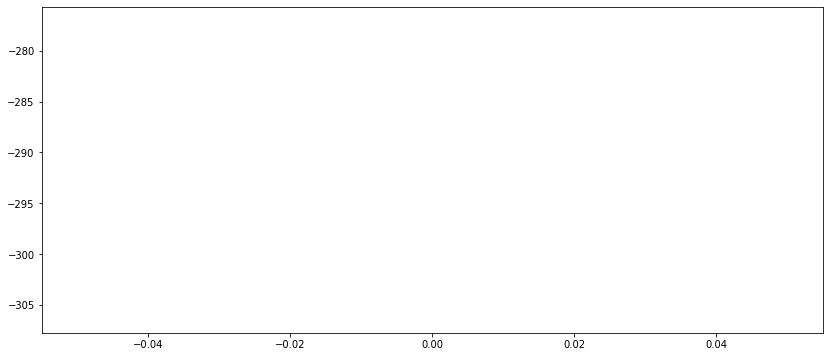

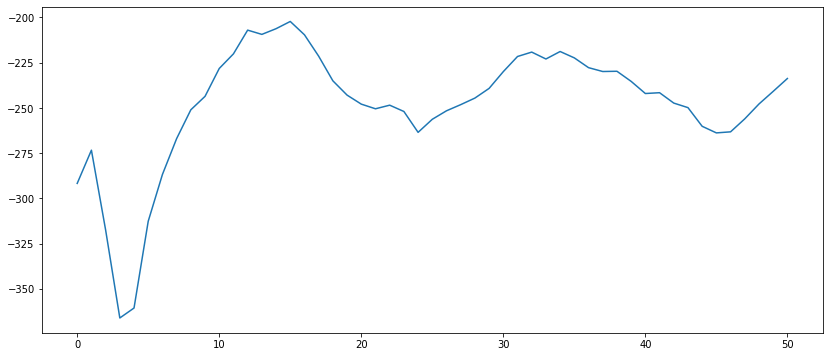

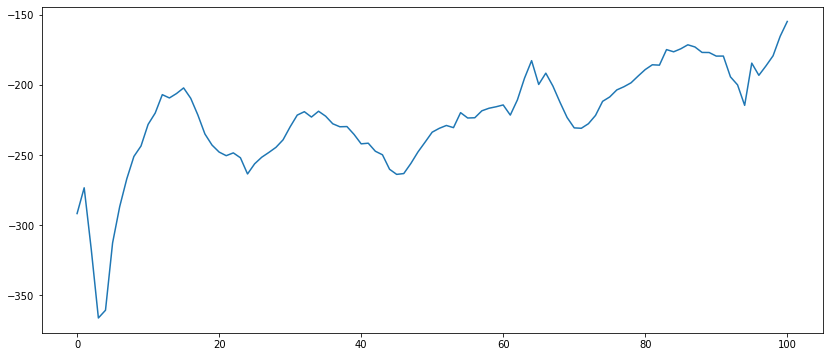

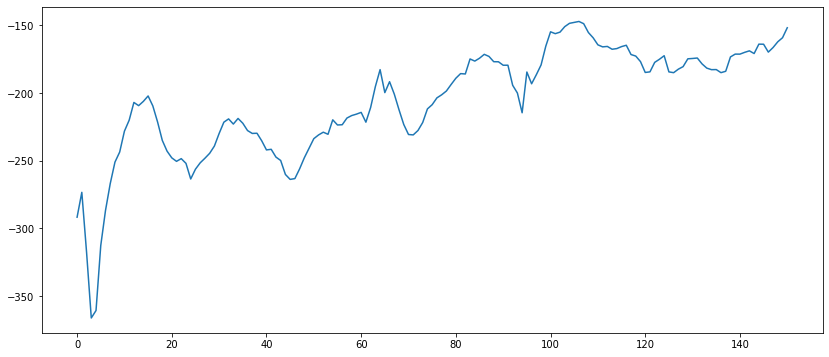

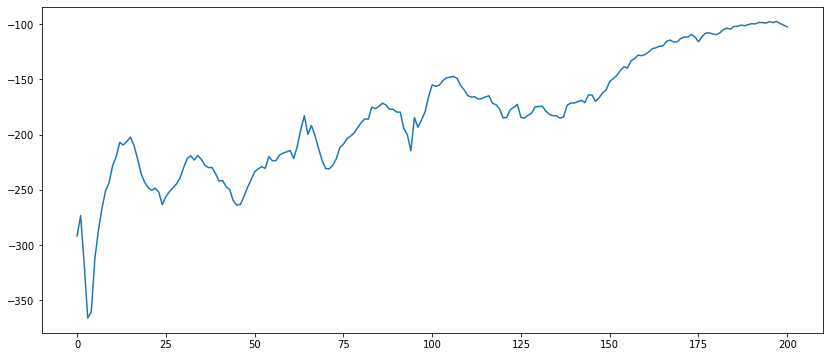

...

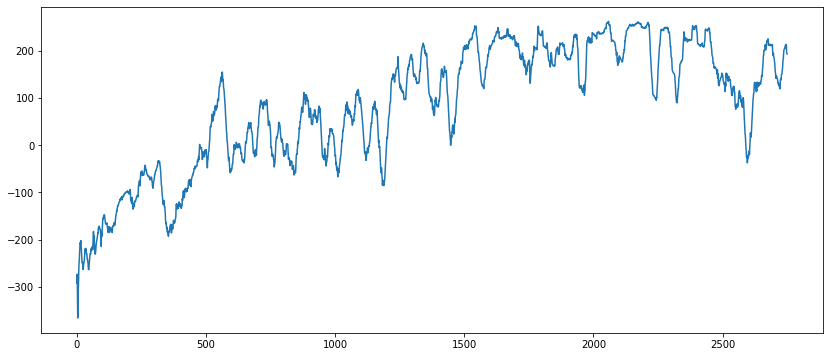

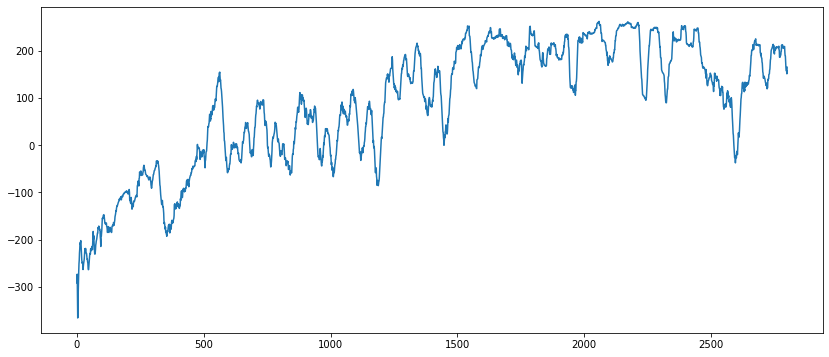

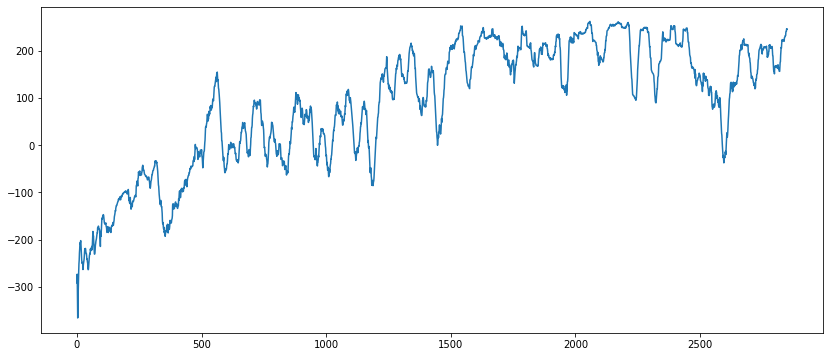

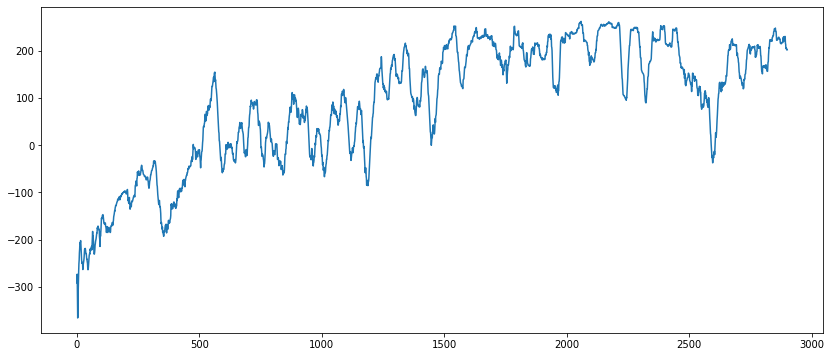

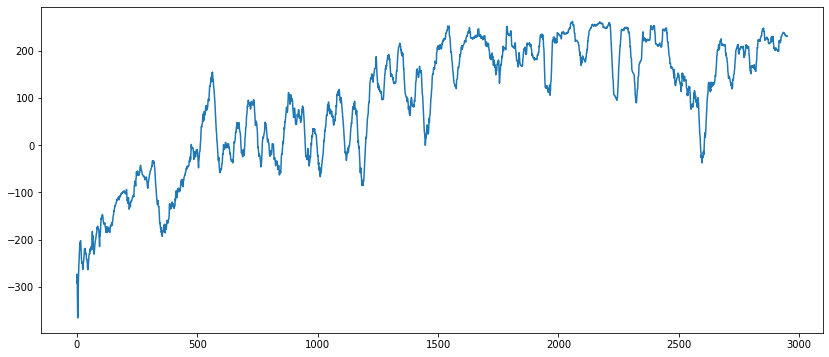

In [ ]:
env = gym.make("LunarLander-v2")
agent = NeuralQLearningAgent(env, memory_replay=True, network_freezing=False, double_q_learning=False)
rewards = run_agent_in_env(env, agent, 3000, learning=True, plot=True, plot_interval=50)

In [ ]:
rewards = run_agent_in_env(env, agent, 100, learning=False, plot=False)

In [ ]:
print('Średni wynik')
print(sum(rewards) / len(rewards))

Średni wynik
210.11917774220754


# 3. Network Freezing

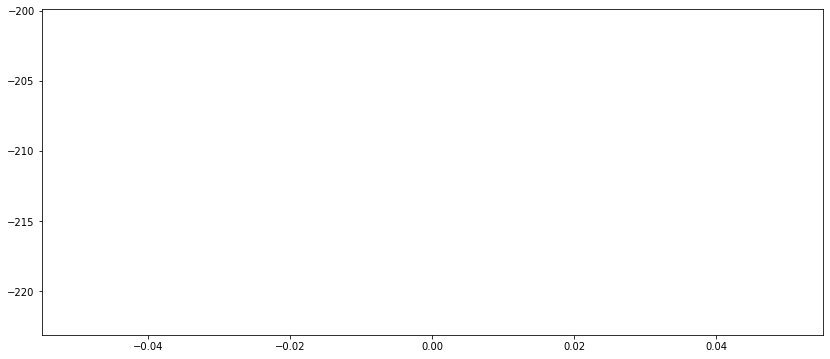

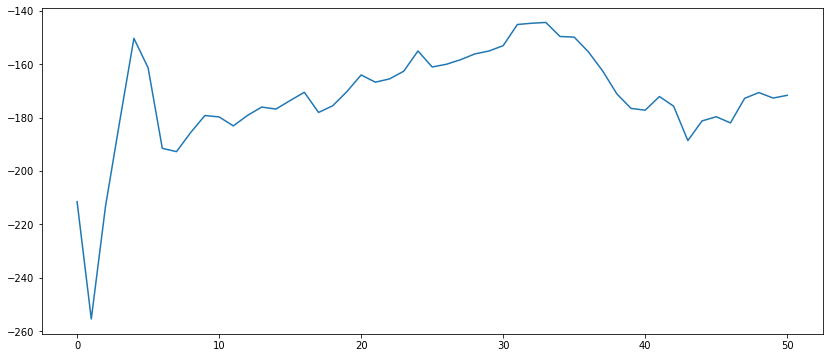

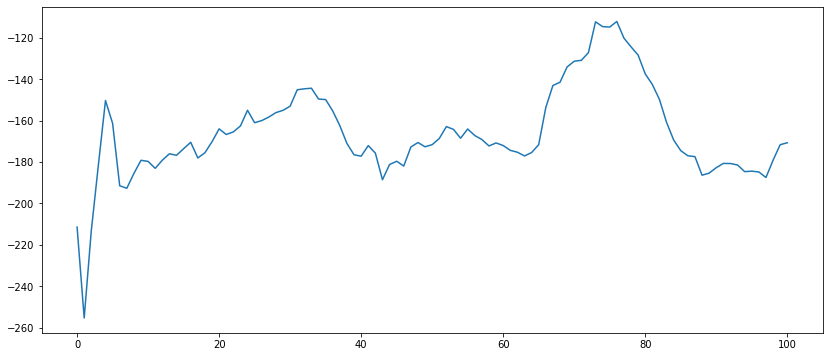

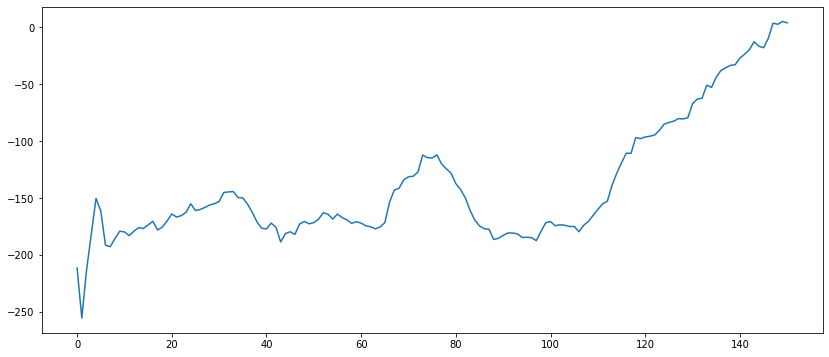

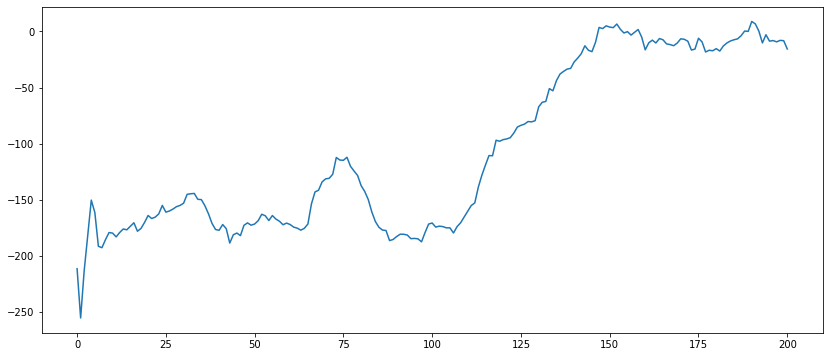

...

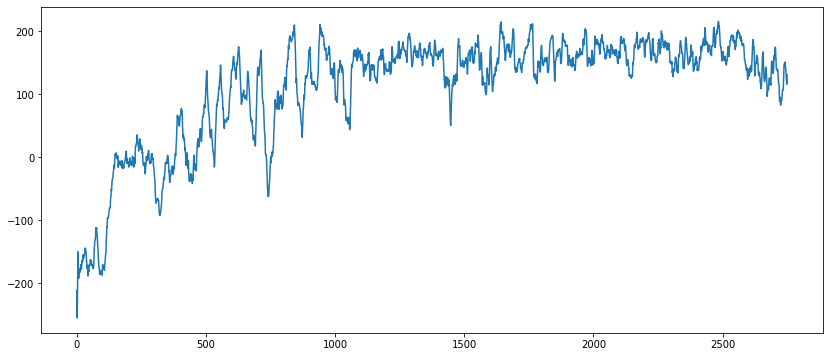

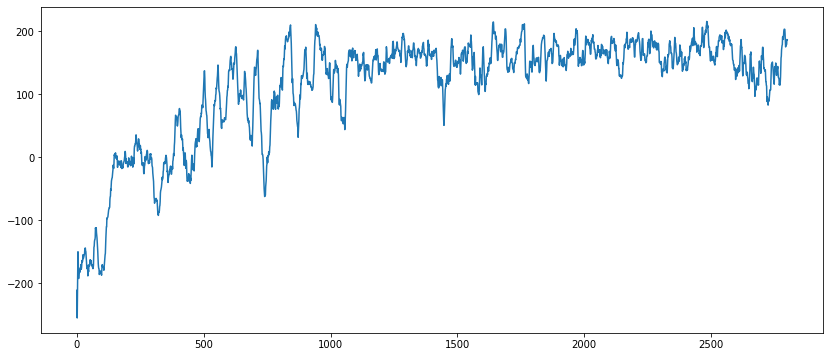

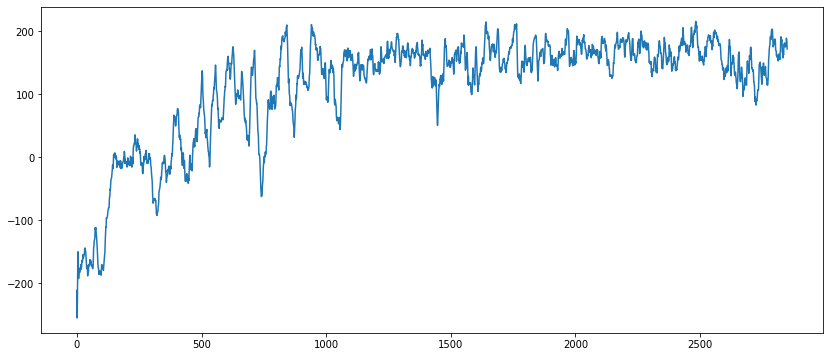

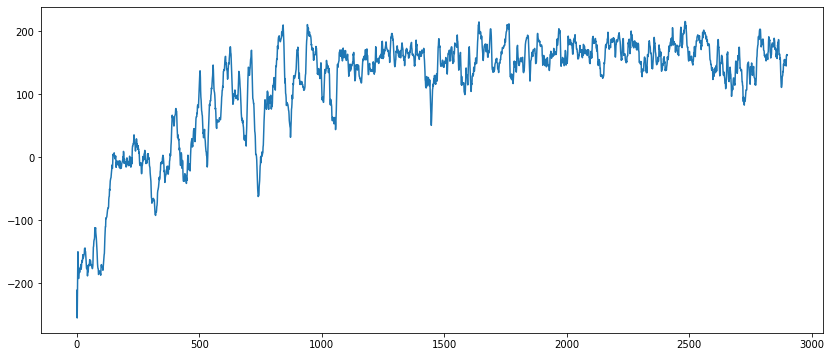

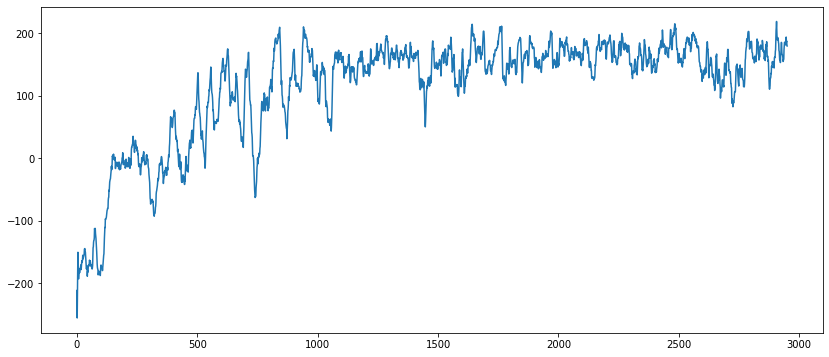

In [ ]:
env = gym.make("LunarLander-v2")
agent = NeuralQLearningAgent(env, memory_replay=False, network_freezing=True, double_q_learning=False)
rewards = run_agent_in_env(env, agent, 3000, learning=True, plot=True, plot_interval=50)

In [ ]:
rewards = run_agent_in_env(env, agent, 100, learning=False, plot=False)

In [ ]:
print('Średni wynik')
print(sum(rewards) / len(rewards))

Średni wynik
233.53190733801733


# 4.  Memory Replay + Network Freezing

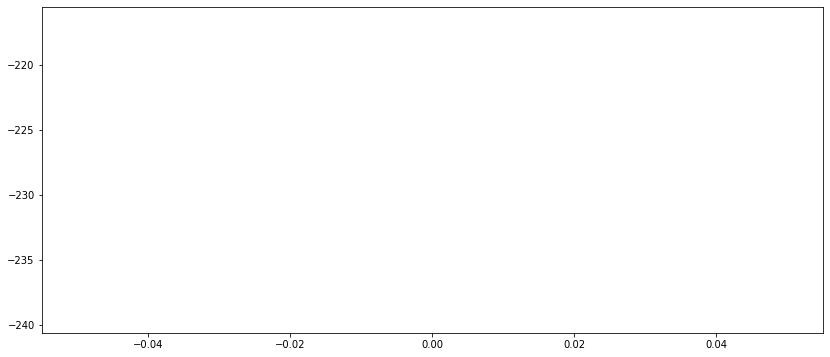

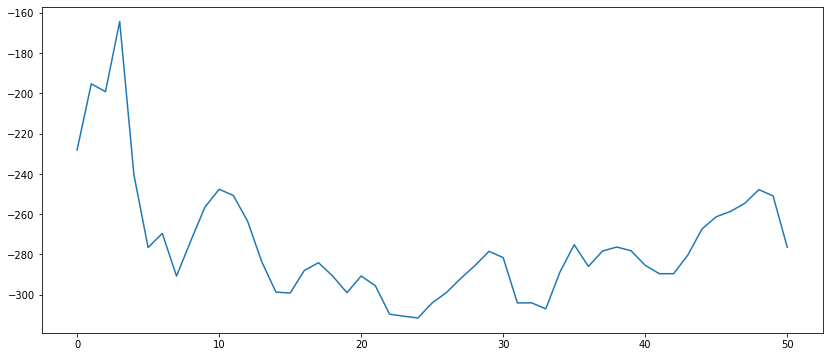

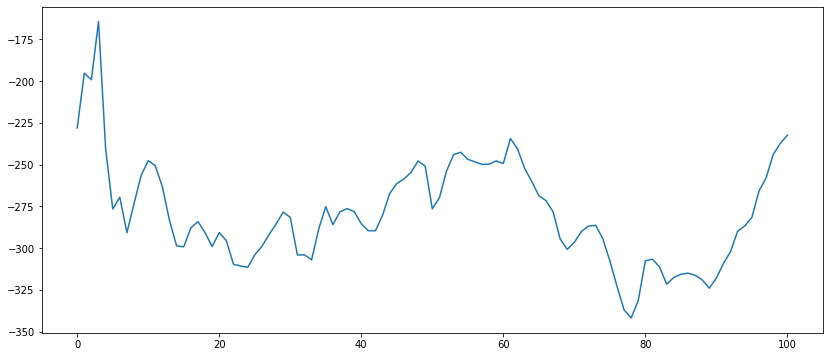

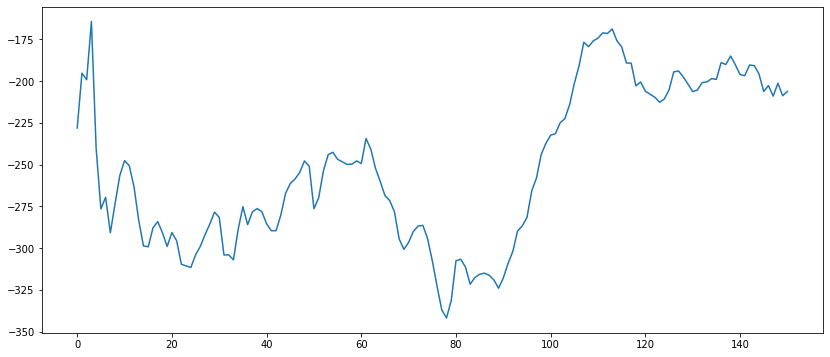

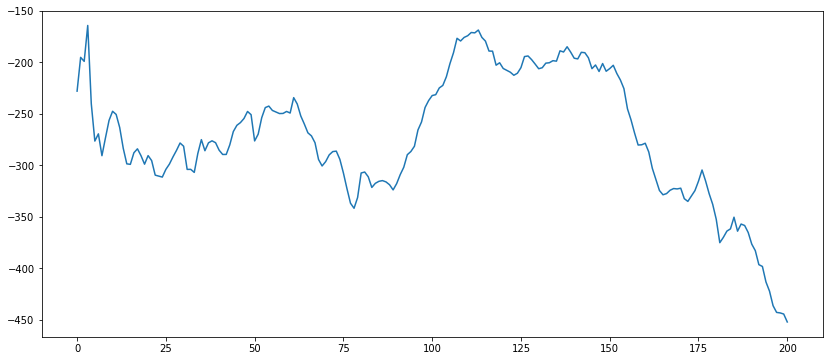

...

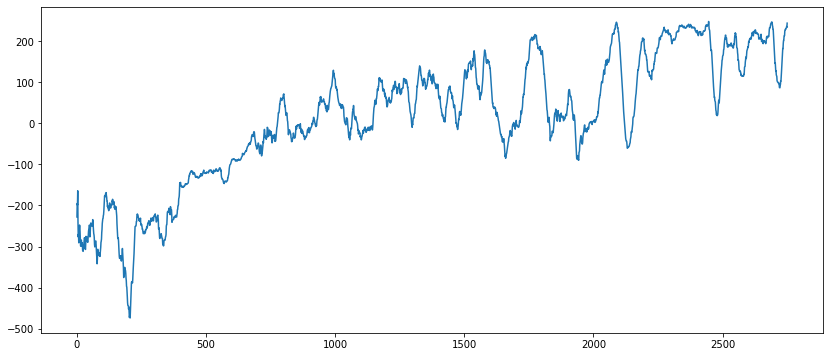

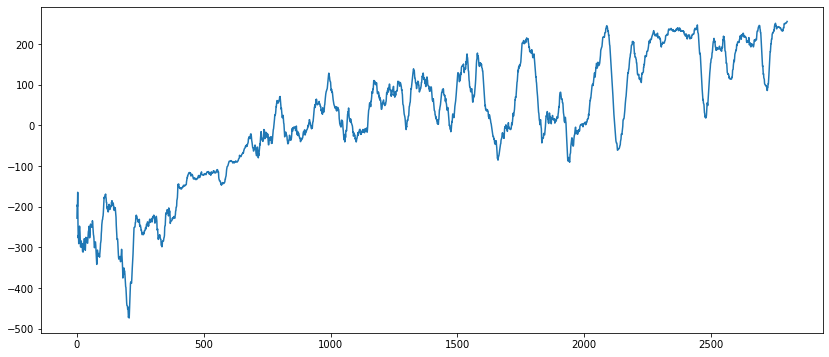

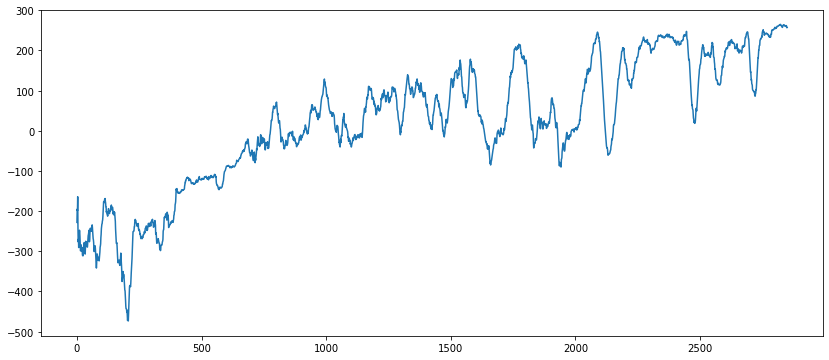

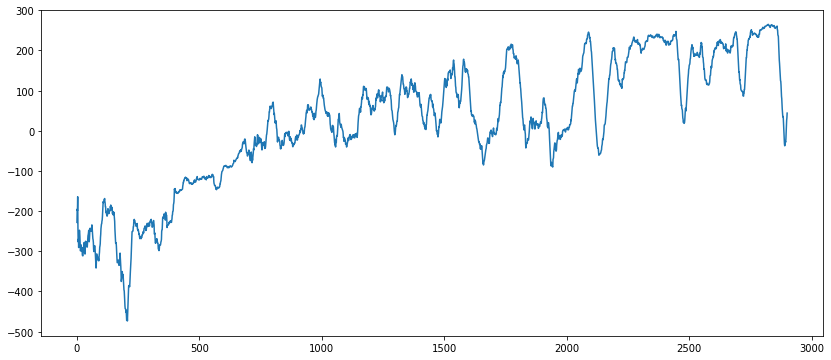

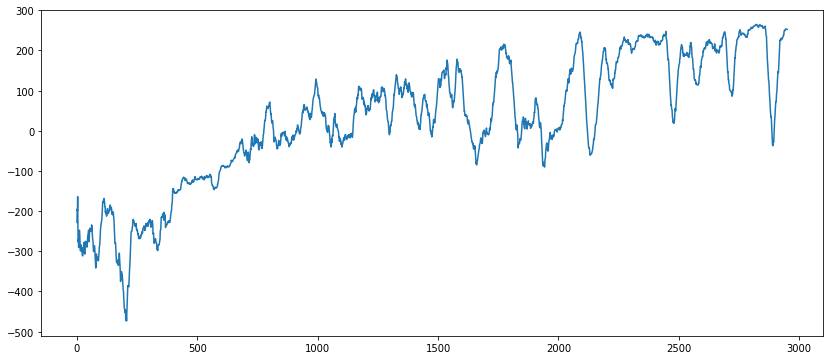

In [ ]:
env = gym.make("LunarLander-v2")
agent = NeuralQLearningAgent(env, memory_replay=True, network_freezing=True, double_q_learning=False)
rewards = run_agent_in_env(env, agent, 3000, learning=True, plot=True, plot_interval=50)

In [ ]:
rewards = run_agent_in_env(env, agent, 100, learning=False, plot=False)

In [ ]:
print('Średni wynik')
print(sum(rewards) / len(rewards))

Średni wynik
265.9232351392748


# 5. Podstawowy Double Q-learning jak w wersji tabelarycznej

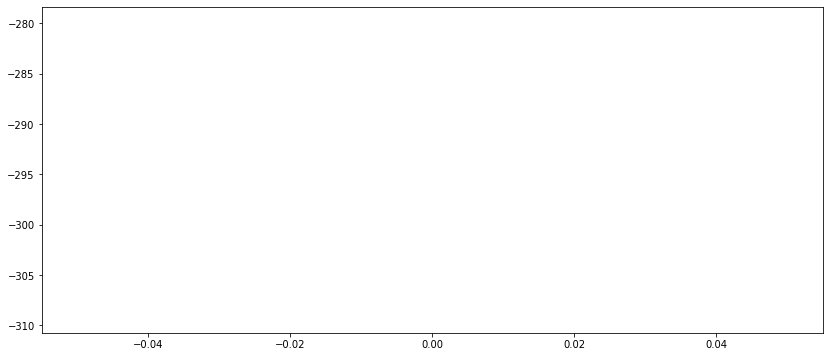

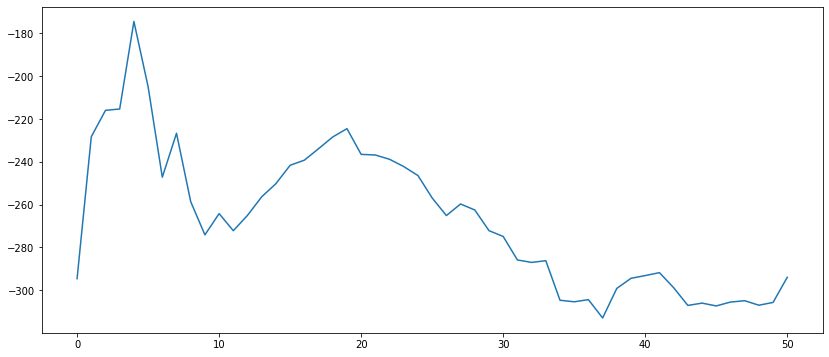

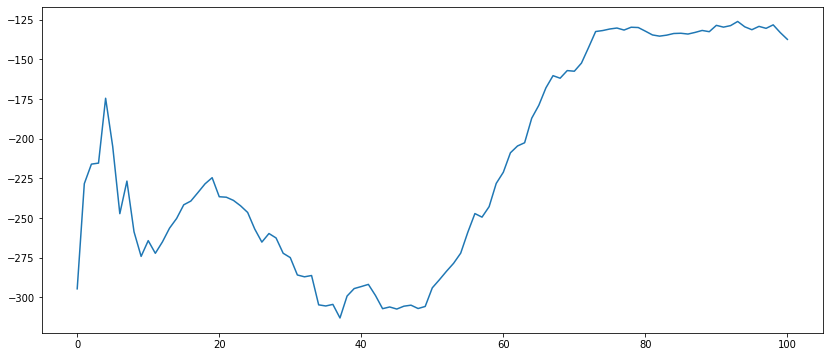

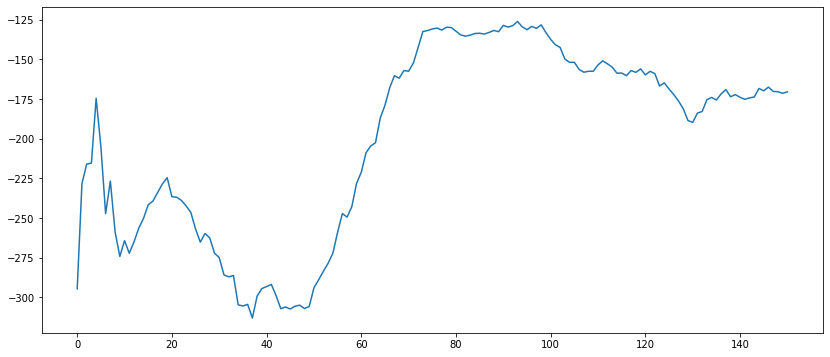

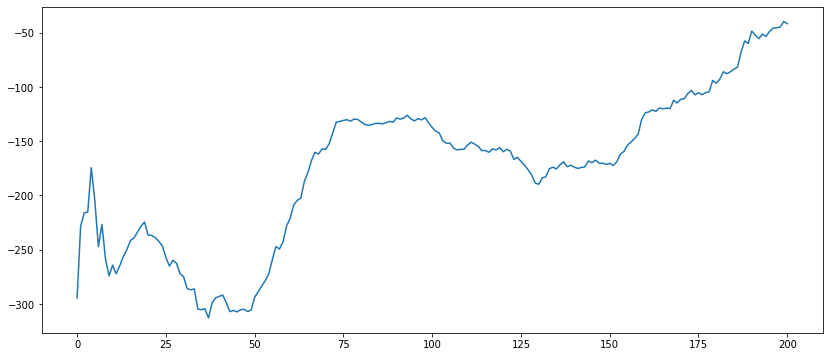

...

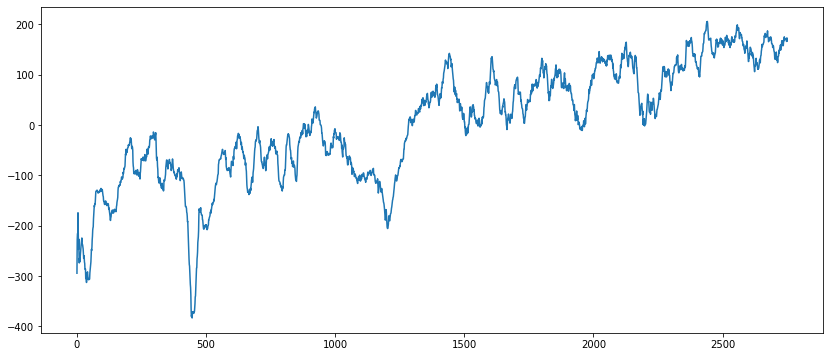

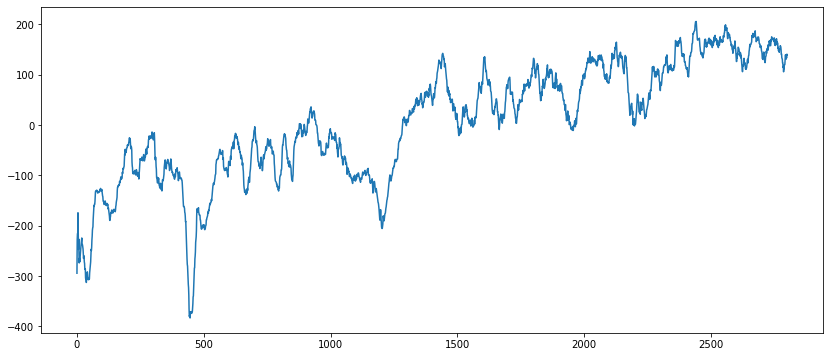

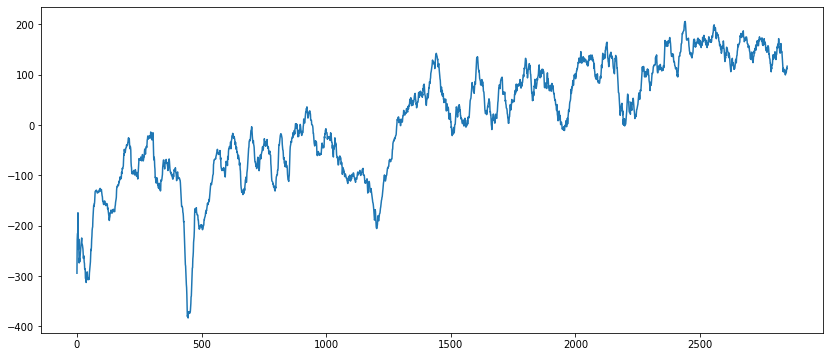

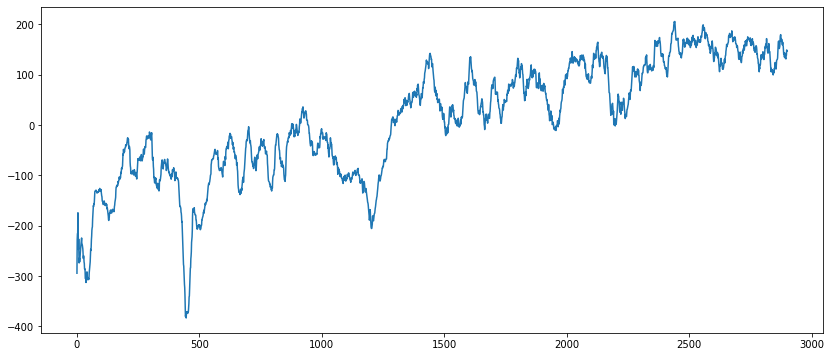

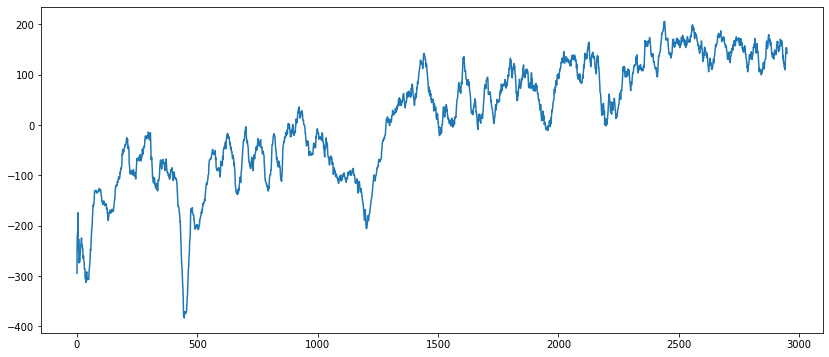

In [ ]:
env = gym.make("LunarLander-v2")
agent = NeuralQLearningAgent(env, tabularlike_double_qlearning=True)
rewards = run_agent_in_env(env, agent, 3000, learning=True, plot=True, plot_interval=50)

In [ ]:
rewards = run_agent_in_env(env, agent, 100, learning=False, plot=False)

In [ ]:
print('Średni wynik')
print(sum(rewards) / len(rewards))

Średni wynik
195.79536254291804


# 6. Double Q-learning

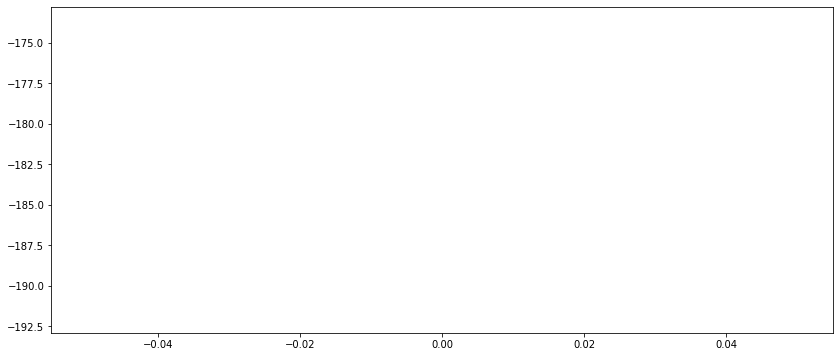

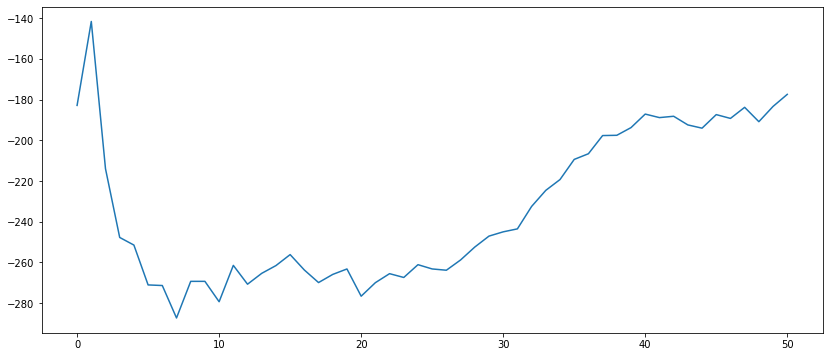

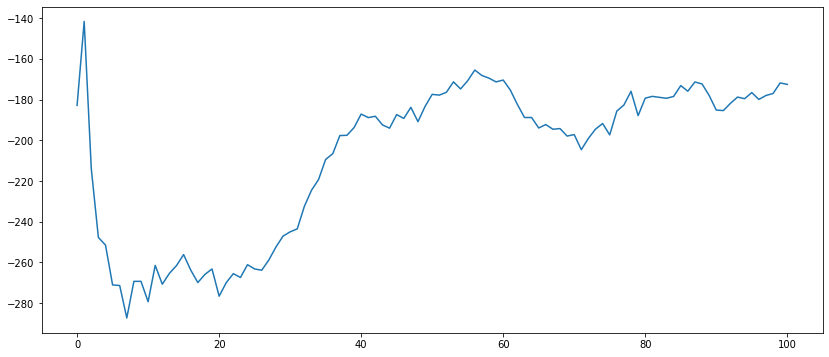

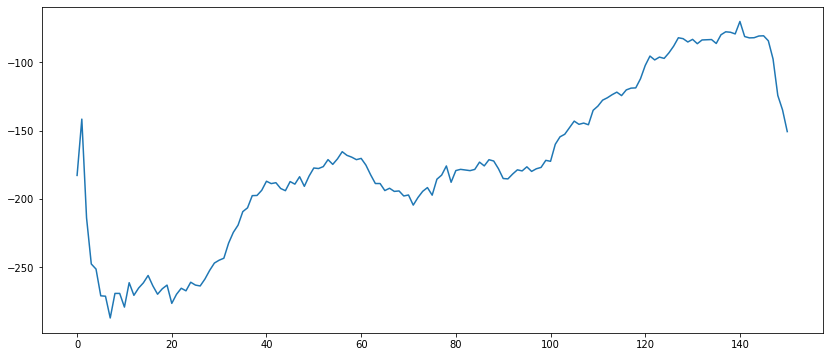

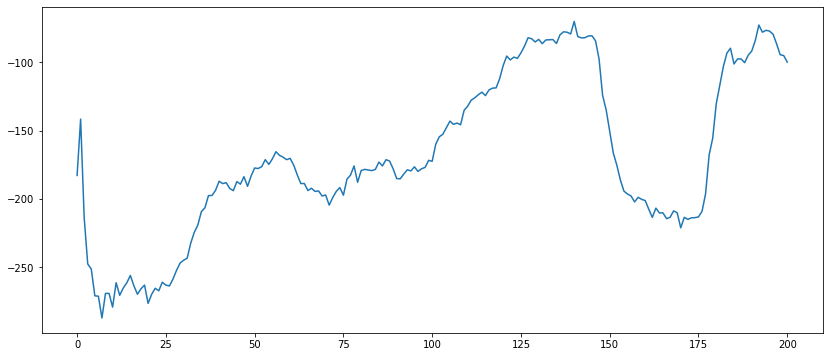

...

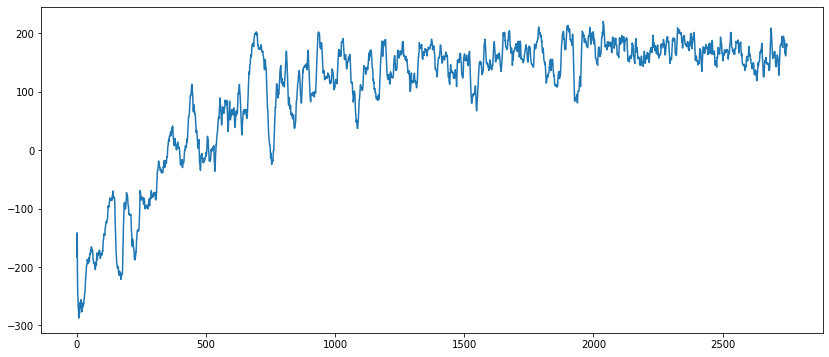

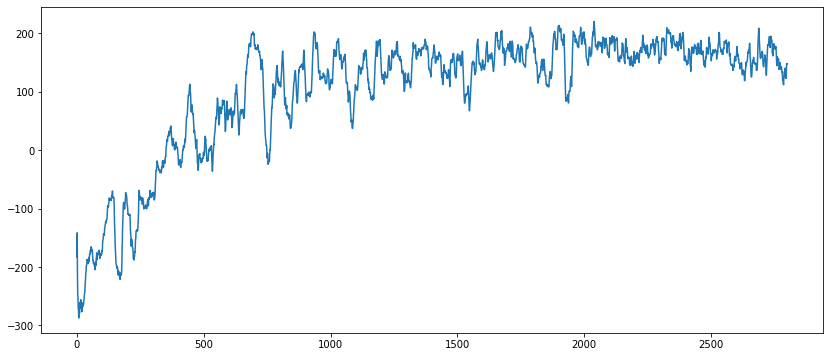

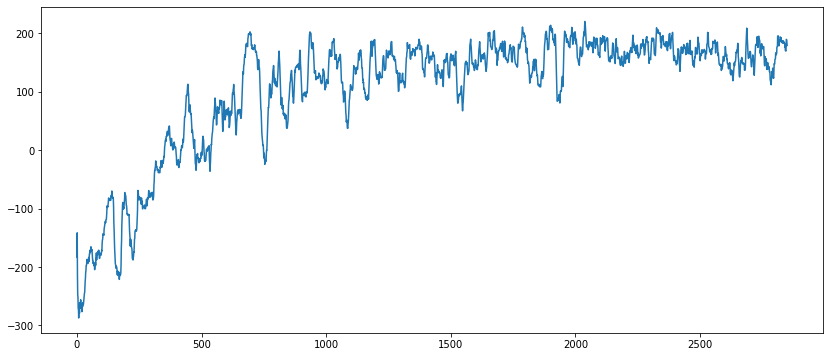

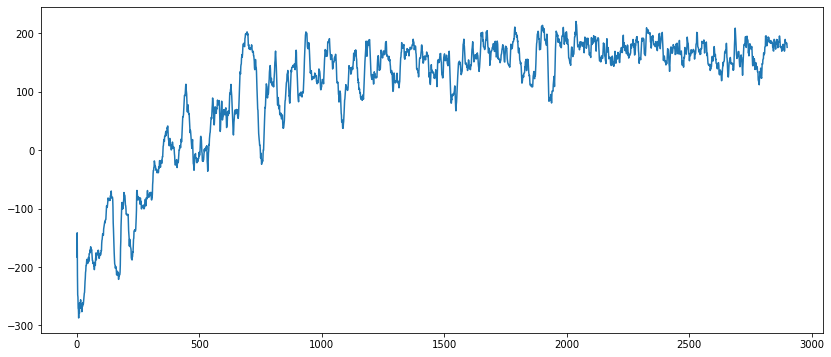

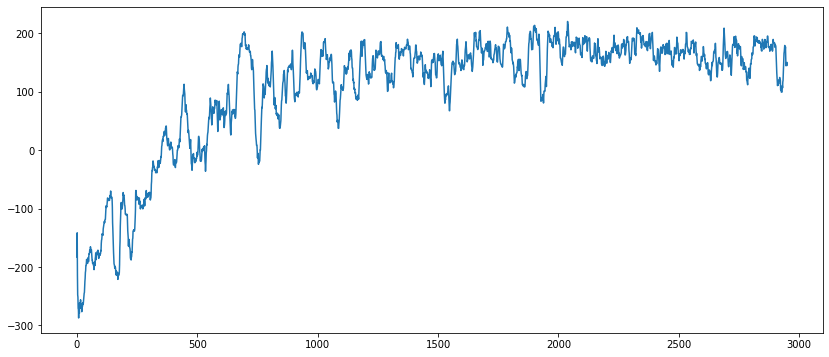

In [ ]:
env = gym.make("LunarLander-v2")
agent = NeuralQLearningAgent(env, memory_replay=False, network_freezing=True, double_q_learning=True)
rewards = run_agent_in_env(env, agent, 3000, learning=True, plot=True, plot_interval=50)

In [ ]:
rewards = run_agent_in_env(env, agent, 100, learning=False, plot=False)

In [ ]:
print('Średni wynik')
print(sum(rewards) / len(rewards))

Średni wynik
223.92918081276596


# 7. Double Q-learning + Memory Replay

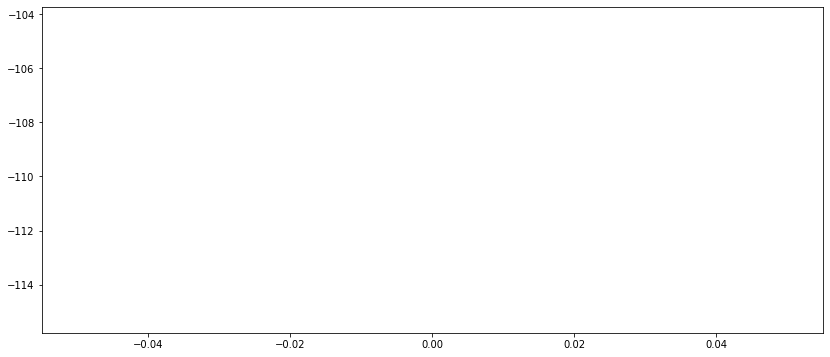

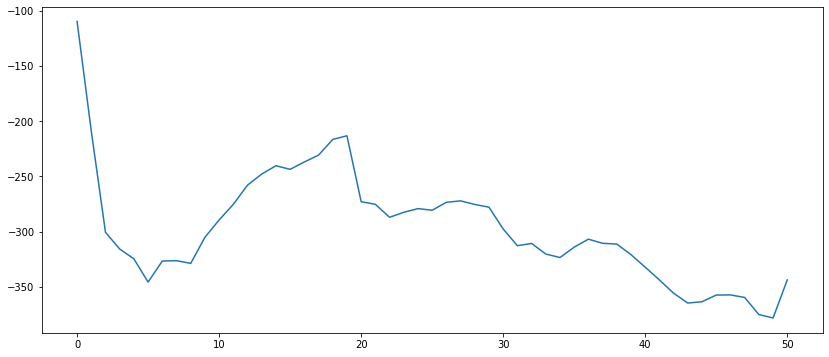

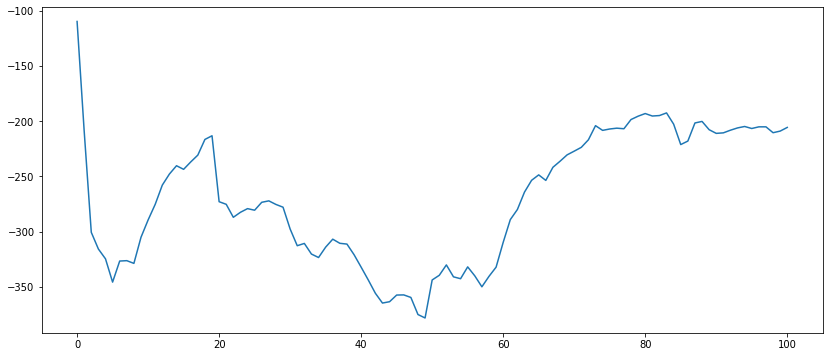

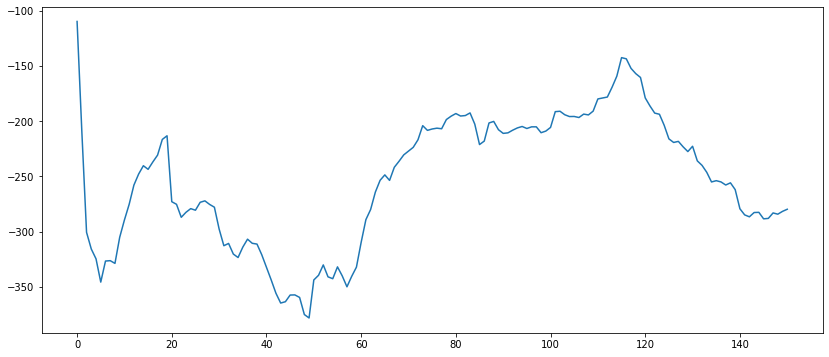

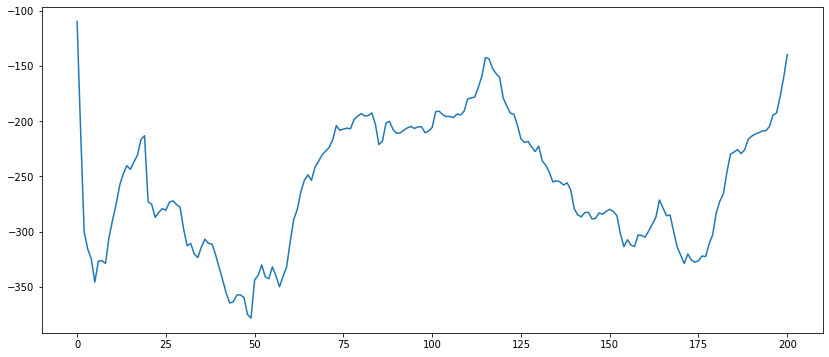

...

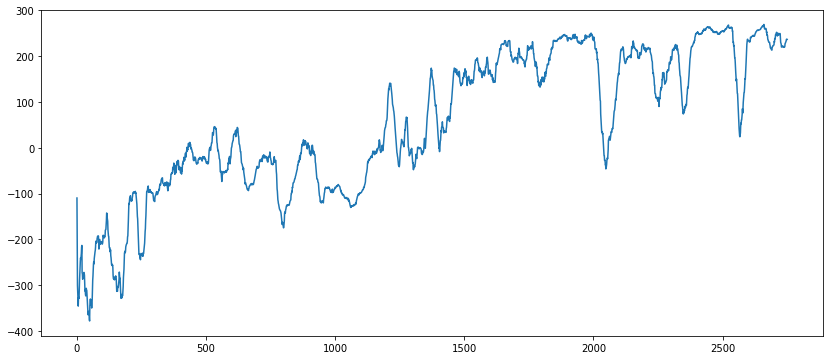

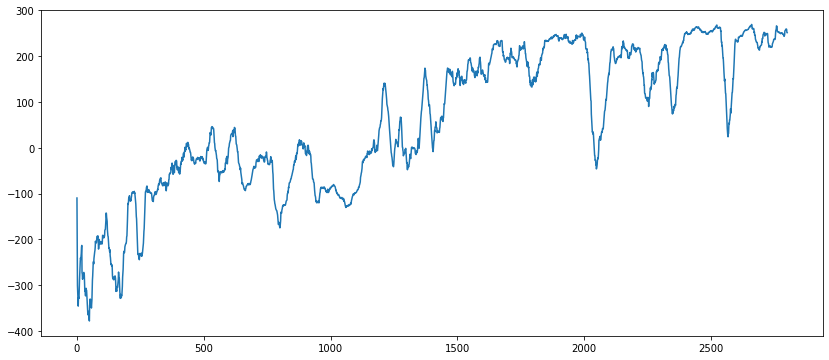

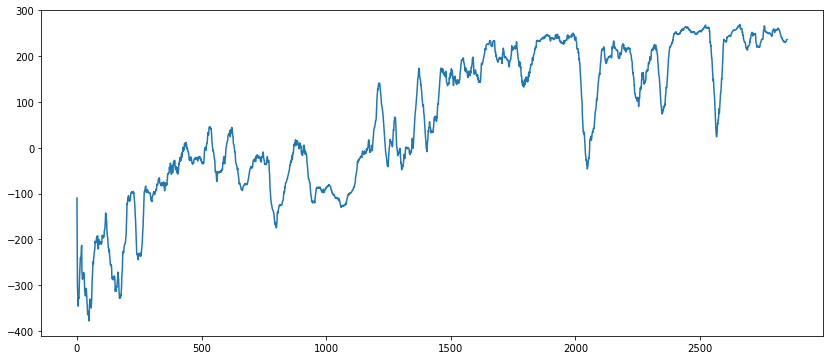

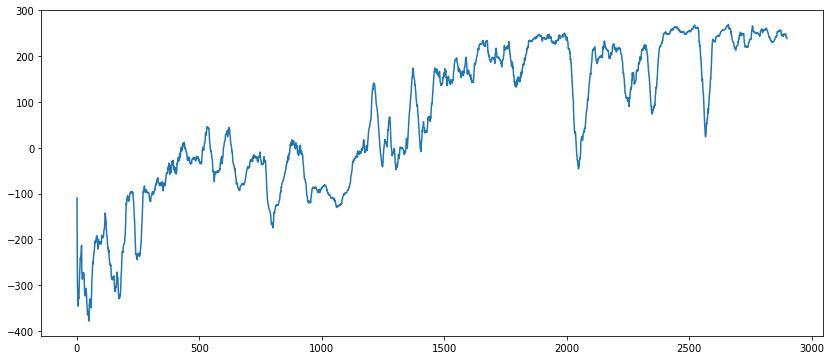

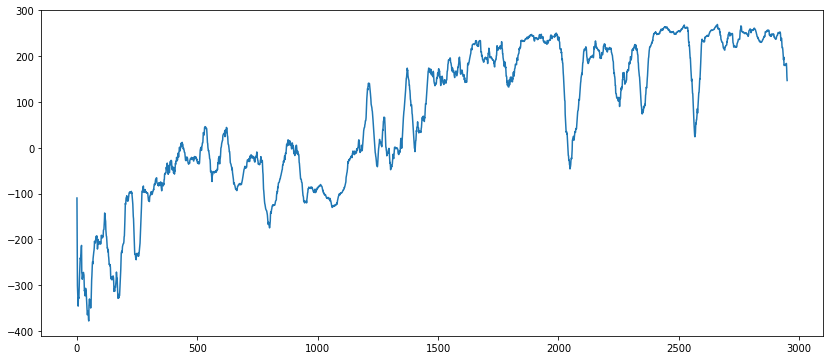

In [ ]:
env = gym.make("LunarLander-v2")
agent = NeuralQLearningAgent(env, memory_replay=True, network_freezing=True, double_q_learning=True)
rewards = run_agent_in_env(env, agent, 3000, learning=True, plot=True, plot_interval=50)

In [ ]:
rewards = run_agent_in_env(env, agent, 100, learning=False, plot=False)

In [ ]:
print('Średni wynik')
print(sum(rewards) / len(rewards))

Średni wynik
251.09722432079892
